# TPM Analysis


In [1]:
import sys
sys.path.insert(1, "/Users/smgroves/Dropbox (VU Basic Sciences)/pycharm_workspace/mazebox/")
import mazebox as mb
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt


Bad key "text.kerning_factor" on line 4 in
/Users/smgroves/Documents/anaconda3/envs/py37/lib/python3.7/site-packages/matplotlib/mpl-data/stylelib/_classic_test_patch.mplstyle.
You probably need to get an updated matplotlibrc file from
https://github.com/matplotlib/matplotlib/blob/v3.1.3/matplotlibrc.template
or from the matplotlib source distribution


# Preprocessing

## Read in Files

In [18]:
indir = "../data/loom/"

samples = ['TKO1','TKO2','TKO3']
[a1,a2,a3] = [mb.pp.read_loom(sample, indir) for sample in samples]


Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.
Variable names are not unique. To make them unique, call `.var_names_make_unique`.


## Filter and concatenate

In [19]:
tfs = ['SP100', 'FOSL1', 'HES1', 'NFKBIZ', 'RELB', 'EPAS1', 'BCL3', 'REST', 'SP110', 'NFKB2', 'TEAD2', 'HMG20B', 'SIX5',
       'RARG', 'TEAD4', 'ZNF217', 'SP140L', 'SOX18', 'HOXC13', 'STAT6', 'ETV4', 'KLF2', 'MITF', 'NR0B2', 'ASCL1', 'ZBTB7C', 'ELF3',
       'RORC', 'FOXA2', 'ETS2','TOX3', 'XBP1', 'ST18', 'FOXA1', 'OVOL2', 'ZNF664', 'TBX10', 'PROX1', 'ETV6', 'CEBPD', 'TFCP2L1', 'FOXJ3',
       'ZNF407', 'ZNF511','ZNF396', 'RBPJ', 'ZSCAN31', 'HOXB5', 'ZNF3', 'TSHZ2', 'ZBTB16', 'ZNF10', 'FLI1', 'GATA4', 'NR0B1', 'NHLH1',
       'NEUROD6', 'ZNF581', 'TCF15', 'LYAR', 'ISL2', 'OLIG2', 'NEUROD1', 'INSM1', 'PAX5', 'SP6', 'MYT1', 'HES6', 'ZNF24', 'ISL1', 'ZNF397',
       'SOX11', 'ZNF253', 'SMAD4', 'RBP1', 'ONECUT2', 'ZNF711', 'DLX5', 'GRIP1', 'ZNF157', 'ZNF713', 'ZNF136', 'FOXN4', 'PATZ1', 'ZNF491',
       'ZBTB21', 'KLF12', 'ZNF501', 'ZNF785', 'CXXC1', 'ZNF324', 'ZNF764', 'ZBTB18', 'KAT8', 'ZNF334', 'POU4F1', 'ZNF250', 'ZNF132',
       'SALL2', 'DLX6', 'MBD1','SOX1', 'ZFP3', 'ZNF543', 'POU2F1', 'NONO', 'SMAD9', 'ZKSCAN2', 'TCF12', 'VEZF1', 'TOX', 'BHLHE22', 'MTA1',
       'TCF3', 'SCRT2', 'RFX7','NHLH2', 'SCRT1', 'RCOR2', 'PURG', 'TBPL1', 'TCF4', 'EBF1', 'ZNF749', 'NEUROD2', 'ZNF423', 'BACH2', 'GLI1',
       'ZFP64','NKX2-1', 'MYC', 'YAP1', 'POU2F3', 'MYCL', 'MYCN', 'ASCL2', 'AVIL', 'CHAT', 'GFI1B',
      'CHGA','EPCAM']


Dropkick is a tool to get rid of empty and low-quality droplets based on ambient reads. It should be applied to each sample separately, so we will apply first and then concantenate the data into one AnnData object.

In [20]:
batch_categories = ['TKO1','TKO2','TKO3']
batch_key = 'tumor'

adata = a1.concatenate([a2,a3], batch_key=batch_key, batch_categories=batch_categories)


In [21]:
adata = mb.pp.scanpy_recipe(adata, retain_genes=tfs,)

Filtered out 12704 genes that are detected in less than 3 cells (spliced).
Normalized count data: X, spliced, unspliced.
Logarithmized X.


## Cell Cycle Regression

calculating cell cycle phase
-->     'S_score' and 'G2M_score', scores of cell cycle phases (adata.obs)


... storing 'phase' as categorical


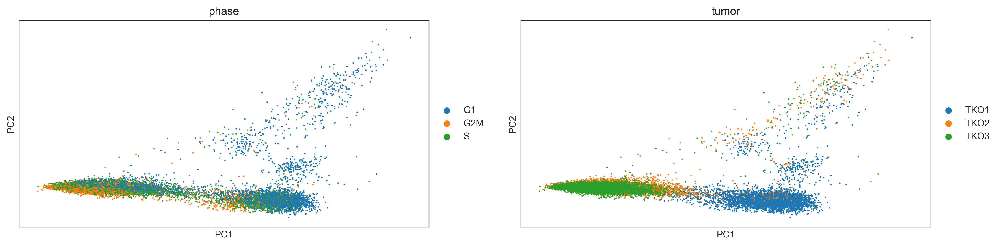

In [22]:
sc.pp.scale(adata)
scv.tl.score_genes_cell_cycle(adata)
sc.tl.pca(adata)
sc.pl.pca_scatter(adata, color=['phase','tumor'])

In [23]:
sc.pp.regress_out(adata, ['S_score', 'G2M_score'])
sc.pp.scale(adata)

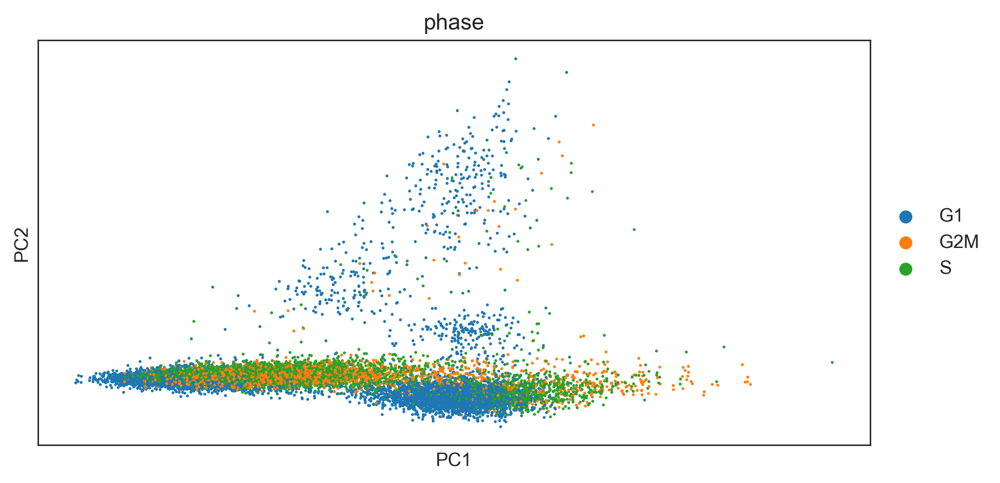

In [24]:
sc.tl.pca(adata)
sc.pl.pca_scatter(adata, color='phase')

# Dimensionality Reduction and RNA Velocity

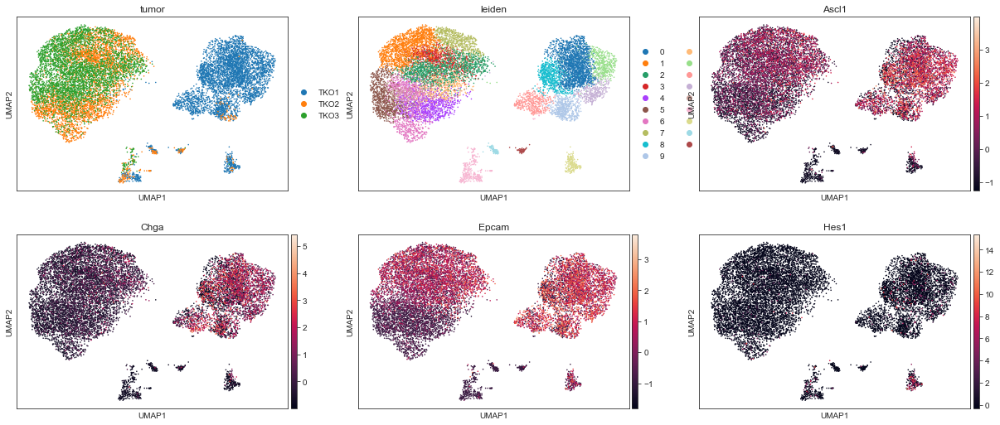

In [9]:
import matplotlib.pyplot as plt
sc.pp.neighbors(adata)
sc.tl.leiden(adata)
sc.tl.umap(adata, random_state = 1)
sc.pl.umap(adata, color = ['tumor','leiden','Ascl1','Chga','Epcam','Hes1'], ncols = 3)


In [10]:
adata.write_h5ad('../int/tko/adata01.h5ad')

In [31]:
adata = sc.read_h5ad('../int/tko/adata01.h5ad')

## Calculating Velocity

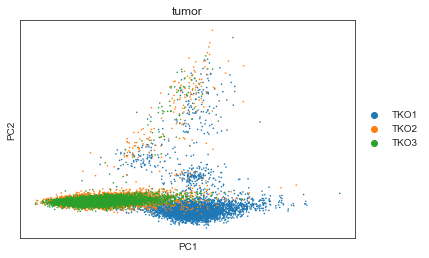

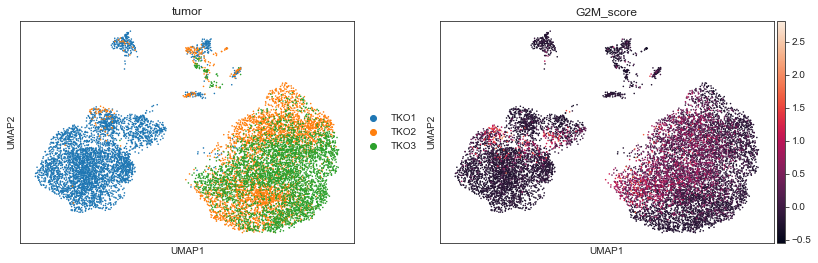

In [11]:
sc.pp.neighbors(adata, random_state=1) #recalculating after subsetting data and cell cycle correction)
sc.tl.pca(adata)
sc.tl.leiden(adata)
sc.tl.umap(adata, random_state=1)
sc.pl.pca(adata, color = 'tumor')
sc.pl.umap(adata, color = ['tumor','G2M_score'])


In [12]:
scv.pp.moments(adata)
scv.tl.velocity(adata, mode = 'deterministic', groupby = 'tumor')
scv.tl.velocity_graph(adata)


computing neighbors
    finished (0:00:04) --> added 
    'distances' and 'connectivities', weighted adjacency matrices (adata.obsp)
computing moments based on connectivities
    finished (0:00:05) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
computing velocities
    finished (0:00:11) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)
computing velocity graph
    finished (0:27:23) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


--> added 'velocity_length' (adata.obs)
--> added 'velocity_confidence' (adata.obs)
--> added 'velocity_confidence_transition' (adata.obs)


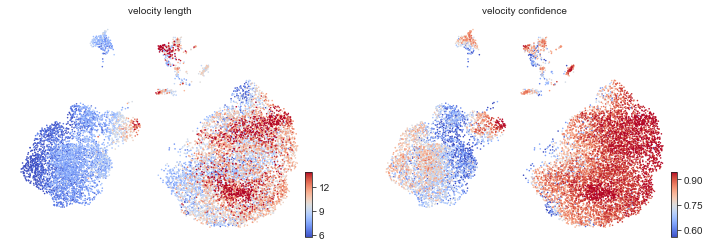

In [14]:
scv.tl.velocity_confidence(adata)

keys = 'velocity_length', 'velocity_confidence'  
scv.pl.scatter(adata, c=keys, cmap='coolwarm', perc=[5, 95], basis = 'umap')

computing velocity embedding
    finished (0:00:05) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)


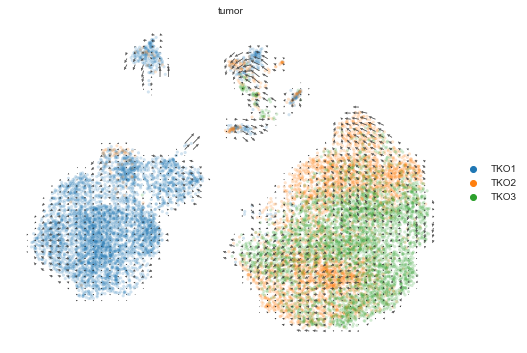

In [15]:
scv.pl.velocity_embedding_grid(adata, basis = 'umap', figsize = (8,6), legend_loc = 'on right',color = 'tumor')


Let's save the data at this point.

In [16]:
adata.write_h5ad('../int/tko/adata02.h5ad')

In [25]:
adata = sc.read_h5ad('../int/tko/adata02.h5ad')

# Pseudotime and plasticity

We would like to see if we can get the same results as Ireland et al. did for their pseudotime analysis. To run Monocle2, we need the R interface `rpy2`. We'll also use the pseudotime inference within scvelo for comparison.

In [26]:
scv.tl.terminal_states(adata, groupby='tumor')

computing terminal states
    identified 7 regions of root cells and 1 region of end points  (TKO1).
    identified 6 regions of root cells and 2 regions of end points  (TKO2).
    identified 4 regions of root cells and 1 region of end points  (TKO3).
    finished (0:00:03) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


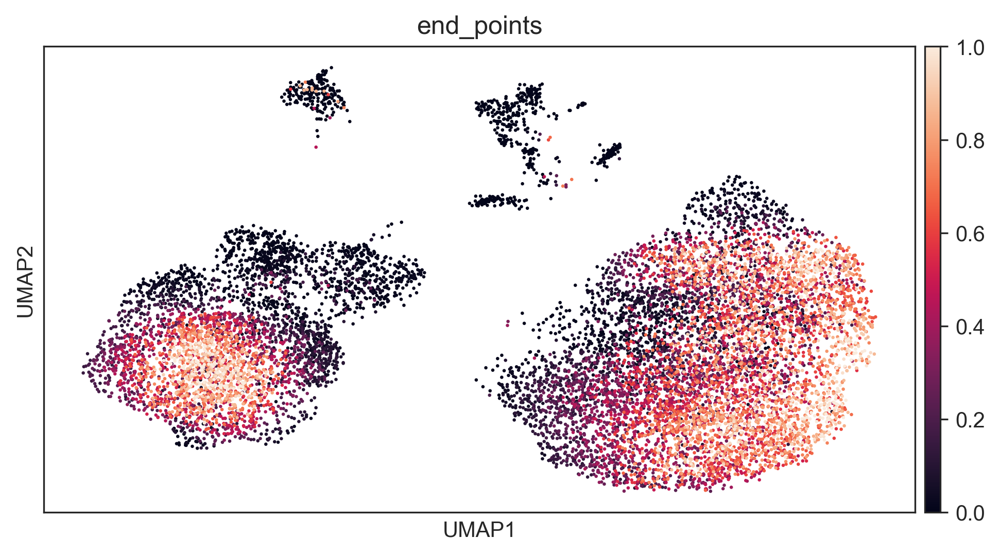

In [27]:
sc.pl.umap(adata, color="end_points")

### Velocity pseudotime

computing terminal states
    identified 10 regions of root cells and 1 region of end points .
    finished (0:00:01) --> added
    'root_cells', root cells of Markov diffusion process (adata.obs)
    'end_points', end points of Markov diffusion process (adata.obs)


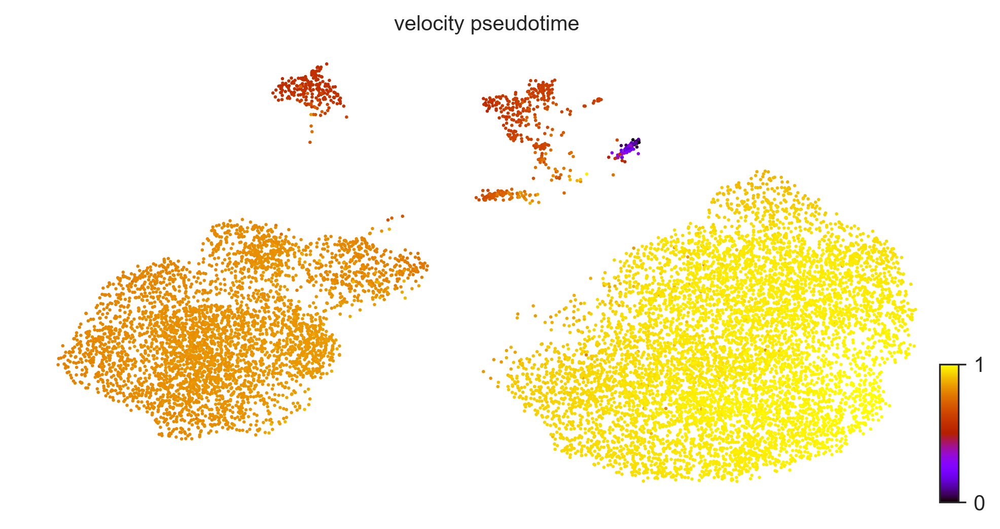

In [29]:
# Velocity pseudotime from scvelo
scv.tl.terminal_states(adata)
scv.tl.velocity_pseudotime(adata)
scv.pl.scatter(adata, color='velocity_pseudotime', cmap='gnuplot', basis = 'umap')


running PAGA using priors: ['velocity_pseudotime']
    finished (0:00:04) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


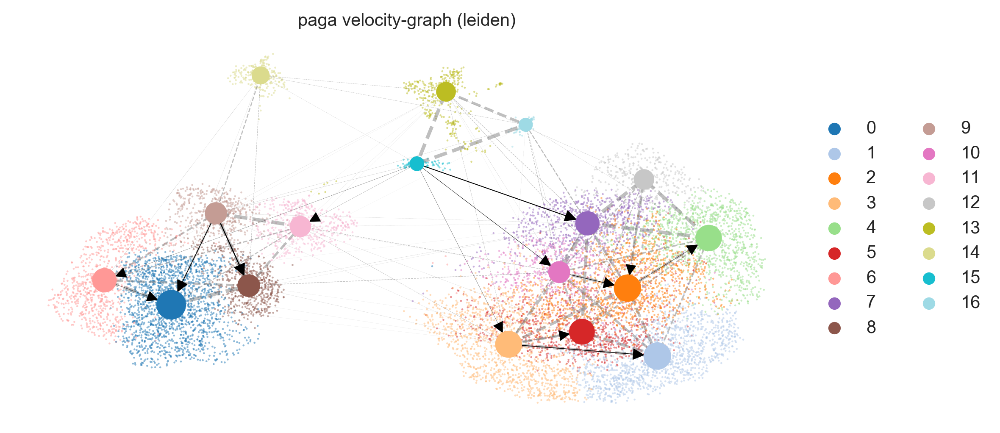

In [30]:
mb.ps.velocity_paga(adata, basis='umap')


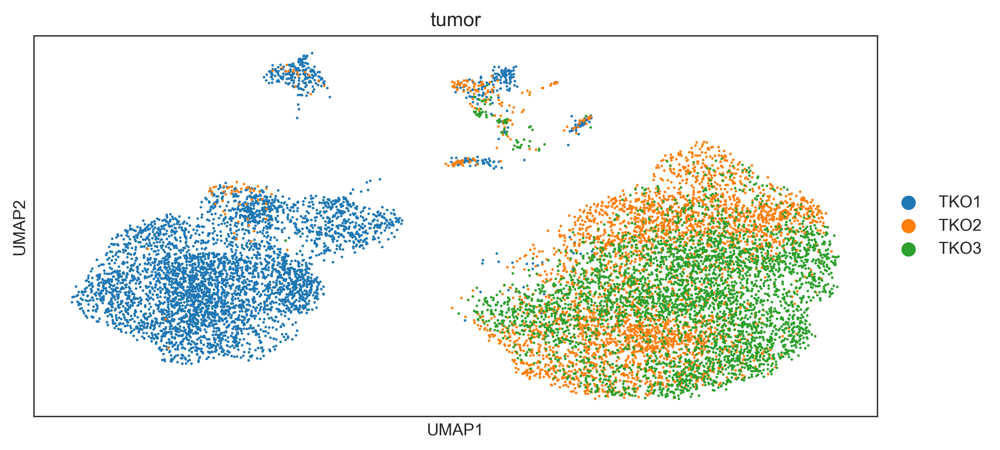

In [31]:
sc.pl.scatter(adata, color = 'tumor', basis = 'umap')


In [32]:
adata.write_h5ad('../int/tko/adata03.h5ad')


In [2]:
adata = sc.read_h5ad('../int/tko/adata03.h5ad')


### Calculate plasticity using CTrP

In [3]:
mb.ps.ctrp_simplified(adata, distance_basis='X_pca', groupby = 'tumor')


(TKO1)
Eigenvalues:  [1.0000027  0.99999726]
(4488, 2)
    identified 2 end points


Trying to set attribute `.obs` of view, copying.


[[0.00569795 0.0099847  0.00619814 ... 0.01215818 0.00900187 0.00817834]
 [0.00360131 0.00839862 0.00999656 ... 0.00900657 0.00818123 0.00536811]
 [0.00590715 0.00877402 0.00557124 ... 0.01465284 0.00589423 0.01553692]
 ...
 [0.00418952 0.00831429 0.00938537 ... 0.00897932 0.00678172 0.00640974]
 [0.0030037  0.01075825 0.00947945 ... 0.01520551 0.01097142 0.0046328 ]
 [0.00352321 0.00846177 0.01113959 ... 0.00852391 0.0078282  0.00521155]]
(TKO2)
Eigenvalues:  [0.99999976]
(3811, 1)
    identified 1 end points


Trying to set attribute `.obs` of view, copying.


[[0.00843268 0.00514844 0.01623532 ... 0.01576468 0.00677001 0.00654473]
 [0.01617813 0.00600326 0.01031635 ... 0.00756052 0.00769398 0.02904805]
 [0.00702077 0.00562674 0.02171798 ... 0.01067321 0.01223316 0.00492483]
 ...
 [0.01729244 0.00678536 0.01157837 ... 0.00850141 0.00857459 0.01873338]
 [0.01399389 0.00619578 0.01254861 ... 0.01188486 0.00942757 0.01139123]
 [0.00974068 0.00507607 0.01769043 ... 0.0104409  0.00971587 0.01012527]]
(TKO3)
Eigenvalues:  [0.99999875]
(3898, 1)
    identified 1 end points


Trying to set attribute `.obs` of view, copying.


[[0.03192769 0.00313337 0.00735318 ... 0.02099066 0.00988897 0.01079366]
 [0.03657029 0.00359405 0.00700358 ... 0.01262146 0.00769941 0.01035278]
 [0.01770038 0.00277034 0.00839424 ... 0.00766273 0.00651155 0.01220245]
 ...
 [0.02696726 0.00334939 0.00773078 ... 0.00961523 0.00690217 0.0113722 ]
 [0.02810283 0.00328621 0.00762895 ... 0.00977972 0.00708712 0.0112469 ]
 [0.05179852 0.00309117 0.0063205  ... 0.0162622  0.00894321 0.00968992]]


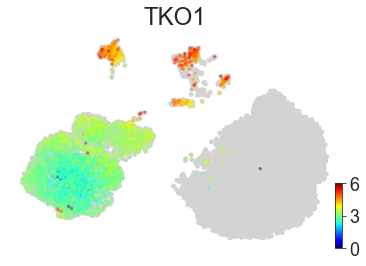

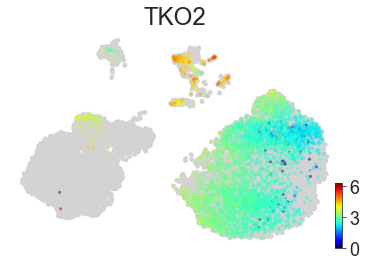

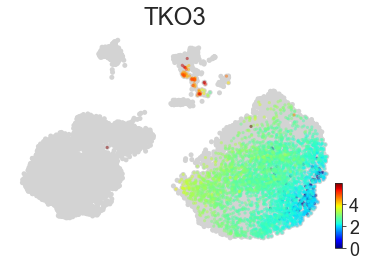

In [4]:
# mb.ps.ctrp(adata, self_transitions=False, adata_dist='X_pca', groupby = 'tumor')

mb.pl.ctrp_groups(adata, groups = 'tumor', basis = 'umap')


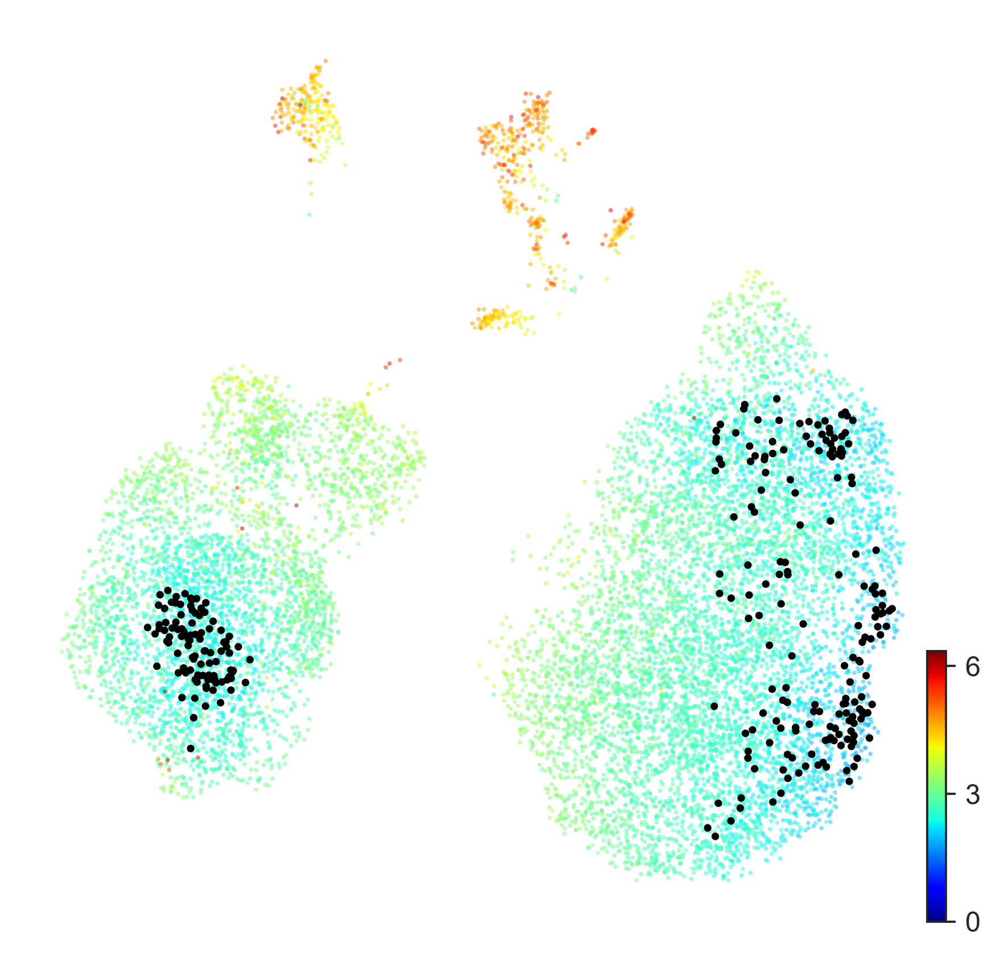

In [5]:
mb.pl.ctrp(adata, basis = 'umap')


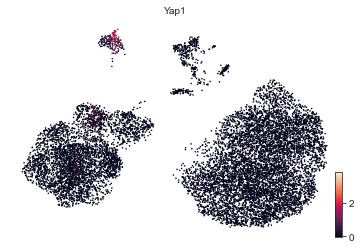

In [9]:
scv.pl.scatter(adata, color = 'Yap1', basis = 'umap', smooth=True)

In [7]:
adata_Xpl = mb.ps.ctrp(adata, self_transitions=False, adata_dist=None,copy=True)


computing terminal states
Eigenvalues:  [1.0000079 0.9974774]
(15257, 2)
    identified 2 end points
Dropping absorbing rows for fundamental matrix...
(14935, 14935)
Calculating fate...
Calculating distances...
Calculating inner product...


TKO1 2.7808445343793555
TKO2 2.477036102519733
TKO3 2.308837544203561


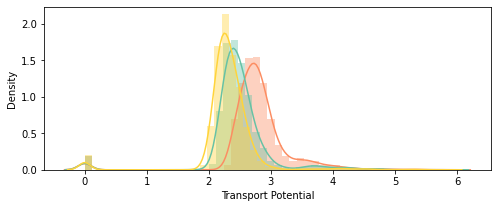

In [10]:
custom_palette = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3', 'purple', 'blue']

mb.pl.ctrp_hist(adata, groups='tumor', bins = 50,figsize = (8,3), custom_palette=custom_palette,fname='tko_hist_new')


TKO1 4.82678410789715
TKO2 4.168285143389907
TKO3 4.229728976051314


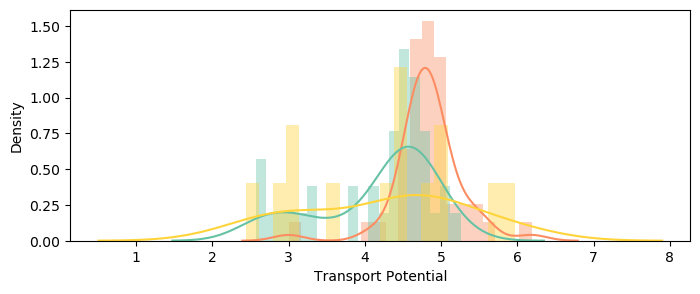

In [63]:
mb.pl.ctrp_hist(adata_small[adata_small.obs['Phenotype']=='SCLC-Y'], groups='tumor', bins = 20,figsize = (8,3), custom_palette=custom_palette,fname='tko_hist')


In [6]:
adata.write_h5ad('../int/tko/adata04.h5ad')


In [7]:
adata = sc.read_h5ad('../int/tko/adata04.h5ad')


# Signature Subtyping

In [2]:
import mazebox as mb
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
adata = sc.read_h5ad('../int/tko/adata05.h5ad')
sig_matrix = pd.read_csv('../data/sig_matrix_ParTI.csv', header =0, index_col = 0)
sig_matrix = sig_matrix / np.linalg.norm(sig_matrix, axis=0)
ind = []
for i in sig_matrix.index:
    ind.append(i.capitalize())
sig_matrix.index = ind


Trying to set attribute `.obs` of view, copying.


Transforming tumor data...
Gene signature matrix now has shape:  (78, 5)
Tumor data shortened to genes in gene list...
(11930, 78)
Tumor data subsetting complete.


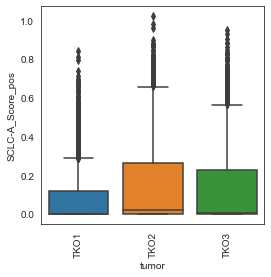

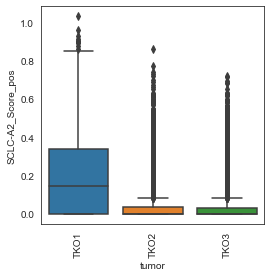

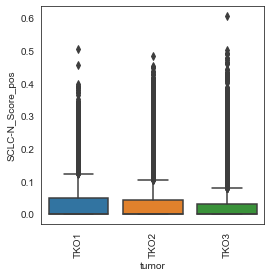

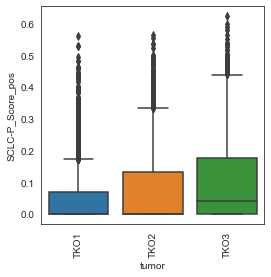

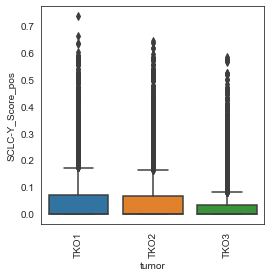

In [4]:
adata, adata_small, sig_matrix2 = mb.ar.phenotyping_recipe(adata, sig_matrix, groupby = 'tumor', save_as = 'tko')


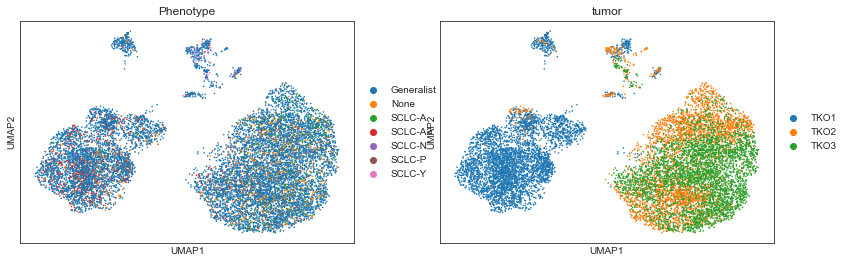

In [6]:
sc.pl.umap(adata_small, color = ['Phenotype','tumor'])

In [7]:
phenotype = []

df = adata.obs[[f"{x}_Score_pos" for x in ['SCLC-N', 'SCLC-A', 'SCLC-P', 'SCLC-Y', 'SCLC-A2']]]

for i, r in df.iterrows():
    test = r * (r > 0)
    if test.max() < .1:
        phenotype.append('Unclassified')

    elif test.max() > .5:
        #     if (test/test.sum()).max()>.9:
        phenotype.append(r.idxmax().split('_')[0])
    else:
        phenotype.append(r.sort_values(ascending=False)[0:2].sort_index().index[0].split('_')[0]+"_"+r.sort_values(ascending=False)[0:2].sort_index().index[1].split('_')[0])


In [8]:
adata.obs['Phenotype_extended'] = phenotype

In [9]:
pd.crosstab( adata.obs['Phenotype'],adata.obs['Phenotype_extended']).style.background_gradient(cmap='viridis')

Phenotype_extended,SCLC-A,SCLC-A2,SCLC-A2_SCLC-A,SCLC-A2_SCLC-N,SCLC-A2_SCLC-P,SCLC-A2_SCLC-Y,SCLC-A_SCLC-N,SCLC-A_SCLC-P,SCLC-A_SCLC-Y,SCLC-N,SCLC-N_SCLC-P,SCLC-N_SCLC-Y,SCLC-P,SCLC-P_SCLC-Y,SCLC-Y,Unclassified
Phenotype,,,,,,,,,,,,,,,,
Generalist,0,0,708,1304,773,1097,881,1577,1125,0,1452,364,0,369,0,0
None,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1115
SCLC-A,543,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SCLC-A2,0,513,0,0,0,0,0,0,0,0,0,0,0,0,0,0
SCLC-N,0,0,0,0,0,0,0,0,0,3,0,0,0,0,0,0
SCLC-P,0,0,0,0,0,0,0,0,0,0,0,0,26,0,0,0
SCLC-Y,0,0,0,0,0,0,0,0,0,0,0,0,0,0,80,0


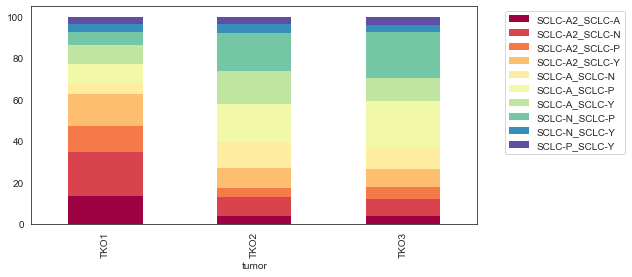

In [10]:
_adata = adata[adata.obs['Phenotype'] == 'Generalist']
plt.rcParams["figure.figsize"] = [8, 4]
((pd.crosstab(_adata.obs["tumor"], _adata.obs['Phenotype_extended']).T /
  pd.crosstab(_adata.obs["tumor"], _adata.obs['Phenotype_extended']).sum(axis=1)) * 100).T.plot(kind='bar',
                                                                                              stacked=True,
                                                                                              linewidth=0, cmap = 'Spectral')
plt.legend(bbox_to_anchor=(1.05, 1))



In [11]:
pd.crosstab( adata.obs['Phenotype_extended'],adata.obs['tumor']).style.background_gradient(cmap='viridis')



tumor,TKO1,TKO2,TKO3
Phenotype_extended,,,
SCLC-A,70,269,204
SCLC-A2,422,50,41
SCLC-A2_SCLC-A,482,112,114
SCLC-A2_SCLC-N,783,272,249
SCLC-A2_SCLC-P,458,128,187
SCLC-A2_SCLC-Y,563,280,254
SCLC-A_SCLC-N,238,477,433
SCLC-A_SCLC-P,340,539,698
SCLC-A_SCLC-Y,326,459,340


## Newer phenotype classification with labeled generalists
Let's check to see how many samples have significant scores (p>.3) for more than one phenotype.

<BarContainer object of 3 artists>

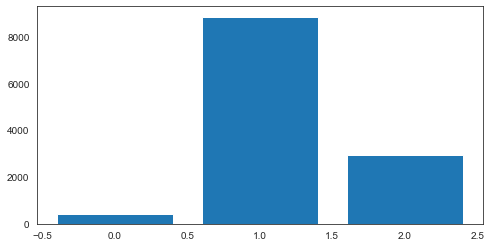

In [12]:
df = adata.obs[[f"{x}_Score_pos" for x in ['SCLC-N', 'SCLC-A', 'SCLC-P', 'SCLC-Y', 'SCLC-A2']]]
# np.unique((df > .3).sum(axis = 1), return_counts=True)[1]
plt.bar(height = np.unique(((df.T/df.sum(axis = 1)).T > .33).sum(axis = 1), return_counts=True)[1], x = range(3), log=False)

In [13]:
arc_pheno = []
arc_aa_type = []

for i,r in df.iterrows():
    r = r/r.sum()
    if (r > .33).sum() > 1:
        arc_aa_type.append('Generalist')
        arc_pheno.append(r.sort_values(ascending=False)[0:2].sort_index().index[0].split('_')[0]+"_"+r.sort_values(ascending=False)[0:2].sort_index().index[1].split('_')[0])
    elif  (r > .33).sum() == 1:
        try:
            arc_aa_type.append(r.idxmax().split('_')[0]+" Specialist")
            arc_pheno.append(r.idxmax().split('_')[0])
        except AttributeError: 
            arc_aa_type.append("Unclassified")
            arc_pheno.append("Unclassified")
    else: 
        arc_aa_type.append("Unclassified")
        arc_pheno.append("Unclassified")
adata.obs['arc_pheno'] = arc_pheno
adata.obs['arc_aa_type'] = arc_aa_type


In [14]:
pd.crosstab(adata.obs['arc_pheno'],adata.obs['tumor']).style.background_gradient(cmap='viridis')

tumor,TKO1,TKO2,TKO3
arc_pheno,,,
SCLC-A,702,1052,974
SCLC-A2,1788,402,427
SCLC-A2_SCLC-A,192,45,51
SCLC-A2_SCLC-N,170,92,87
SCLC-A2_SCLC-P,169,48,73
SCLC-A2_SCLC-Y,148,82,66
SCLC-A_SCLC-N,25,65,61
SCLC-A_SCLC-P,131,221,292
SCLC-A_SCLC-Y,92,193,136


In [15]:
pd.crosstab( adata.obs['arc_pheno'],adata.obs['Phenotype']).style.background_gradient(cmap='viridis')

Phenotype,Generalist,None,SCLC-A,SCLC-A2,SCLC-N,SCLC-P,SCLC-Y
arc_pheno,,,,,,,
SCLC-A,2093,113,522,0,0,0,0
SCLC-A2,2002,114,0,501,0,0,0
SCLC-A2_SCLC-A,259,29,0,0,0,0,0
SCLC-A2_SCLC-N,309,30,0,10,0,0,0
SCLC-A2_SCLC-P,274,15,0,1,0,0,0
SCLC-A2_SCLC-Y,273,22,0,1,0,0,0
SCLC-A_SCLC-N,118,33,0,0,0,0,0
SCLC-A_SCLC-P,593,49,2,0,0,0,0
SCLC-A_SCLC-Y,361,34,19,0,0,0,7


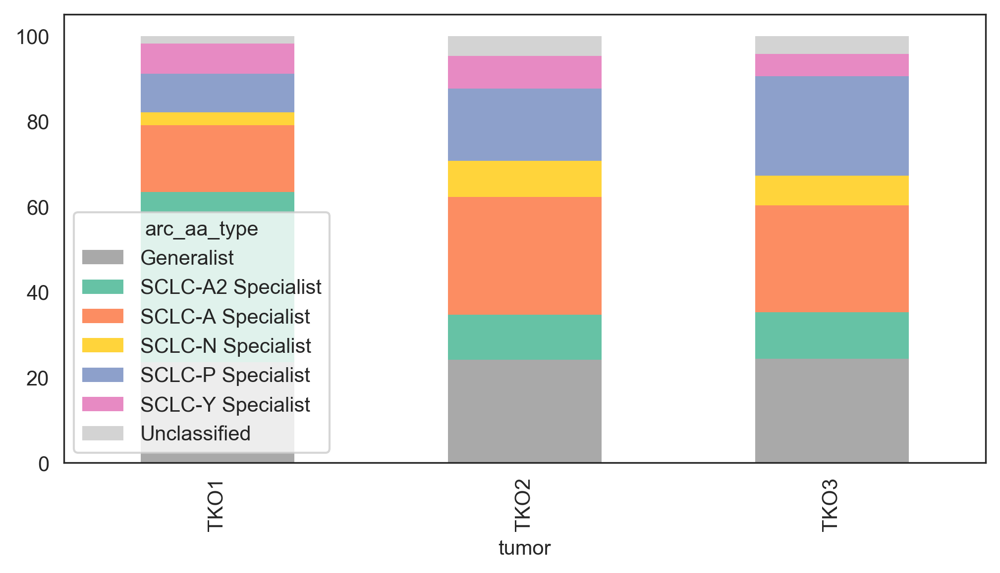

In [7]:
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y Specialist': cp[4], 'SCLC-A Specialist': cp[0], 'SCLC-A2 Specialist': cp[1], 'SCLC-N Specialist': cp[2], 'SCLC-P Specialist': cp[3],
              'Generalist': 'darkgrey', 'Unclassified': 'lightgrey'}
mb.pl.subtype_bar(adata,groupby='tumor', fname = 'tko', pheno_name="arc_aa_type", custom_palette=color_dict)

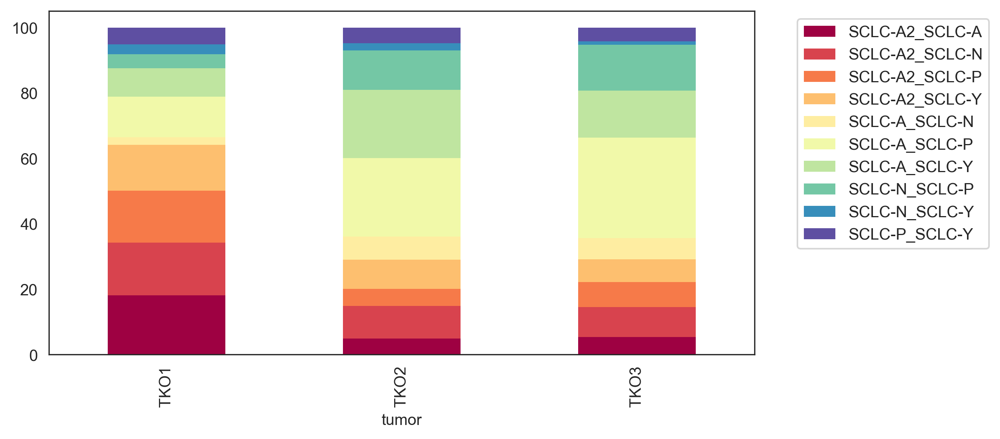

In [19]:
_adata = adata[adata.obs['arc_aa_type'] == 'Generalist']
plt.rcParams["figure.figsize"] = [8, 4]
((pd.crosstab(_adata.obs["tumor"], _adata.obs['arc_pheno']).T /
  pd.crosstab(_adata.obs["tumor"], _adata.obs['arc_pheno']).sum(axis=1)) * 100).T.plot(kind='bar',
                                                                                              stacked=True,
                                                                                              linewidth=0, cmap = 'Spectral')
plt.legend(bbox_to_anchor=(1.05, 1))

plt.savefig('./figures/tko/arc_aa_generalist_subtypes.pdf')

TKO1
Index(['SCLC-A2_Score', 'SCLC-Y_Score', 'SCLC-N_Score'], dtype='object')


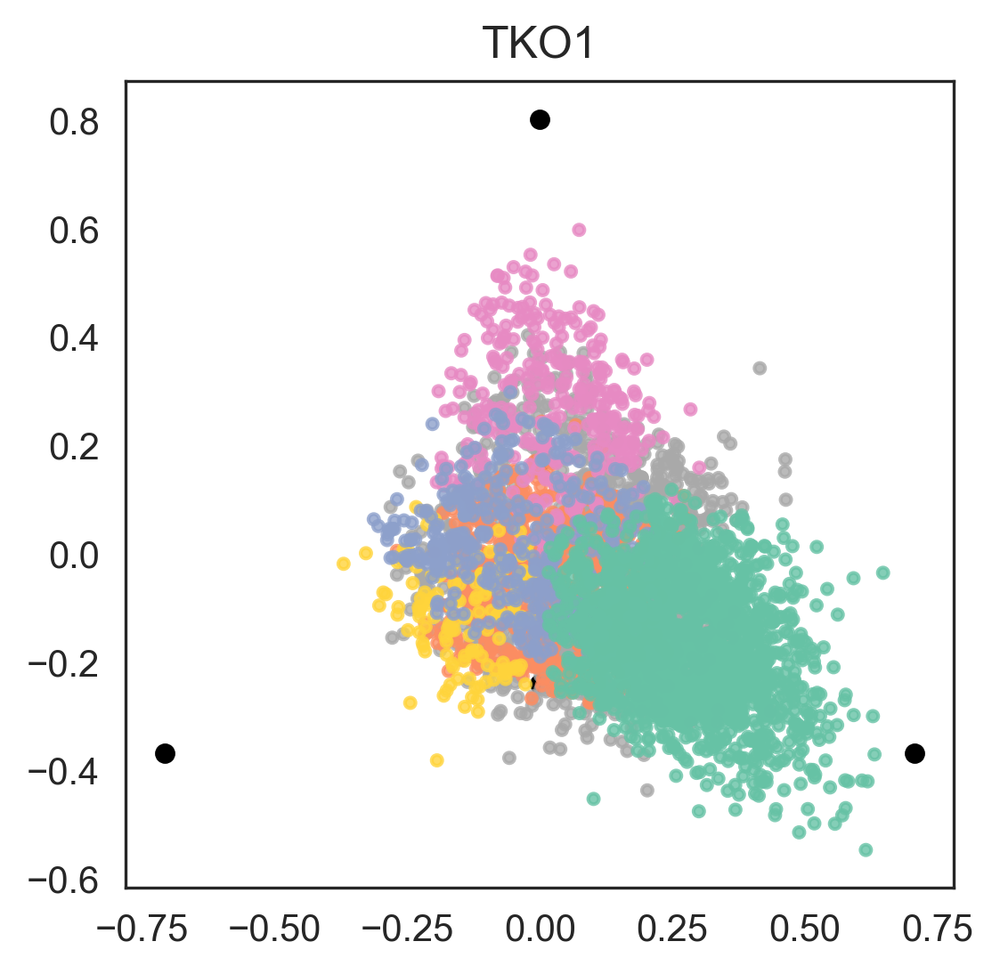

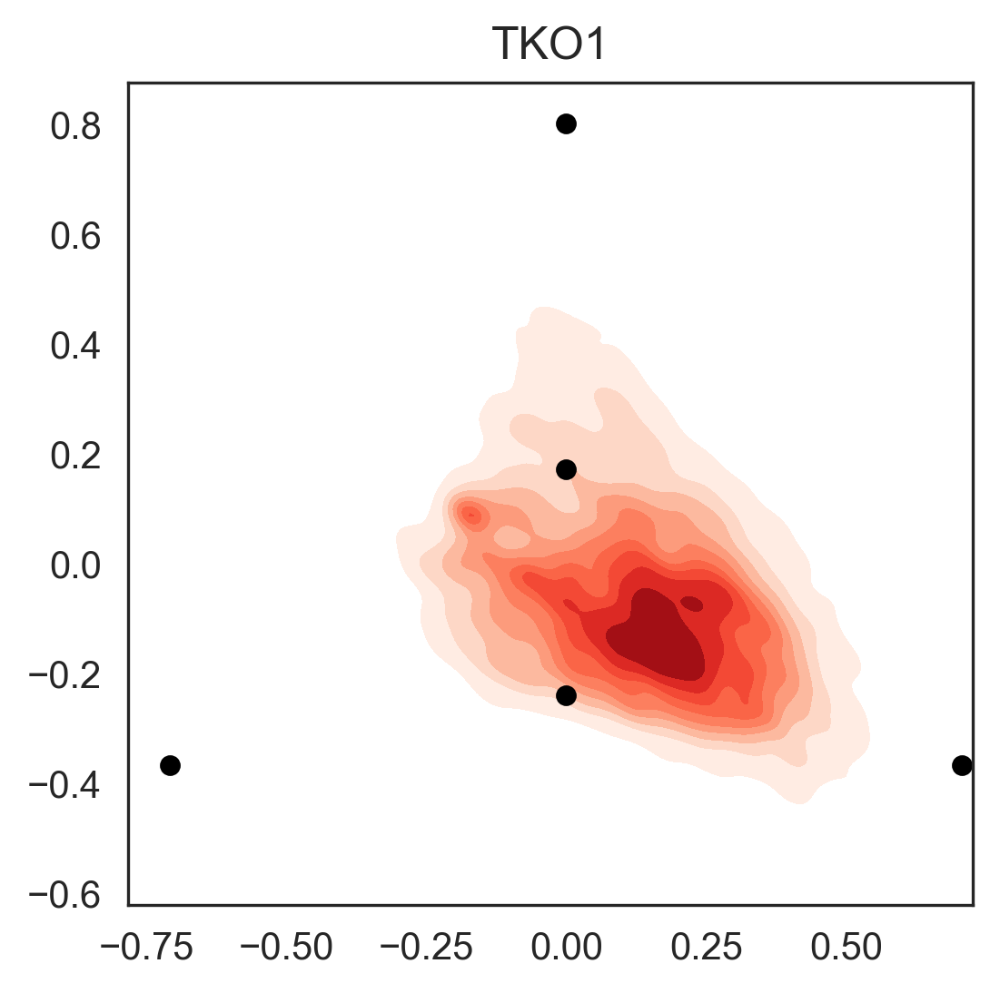

TKO2
Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


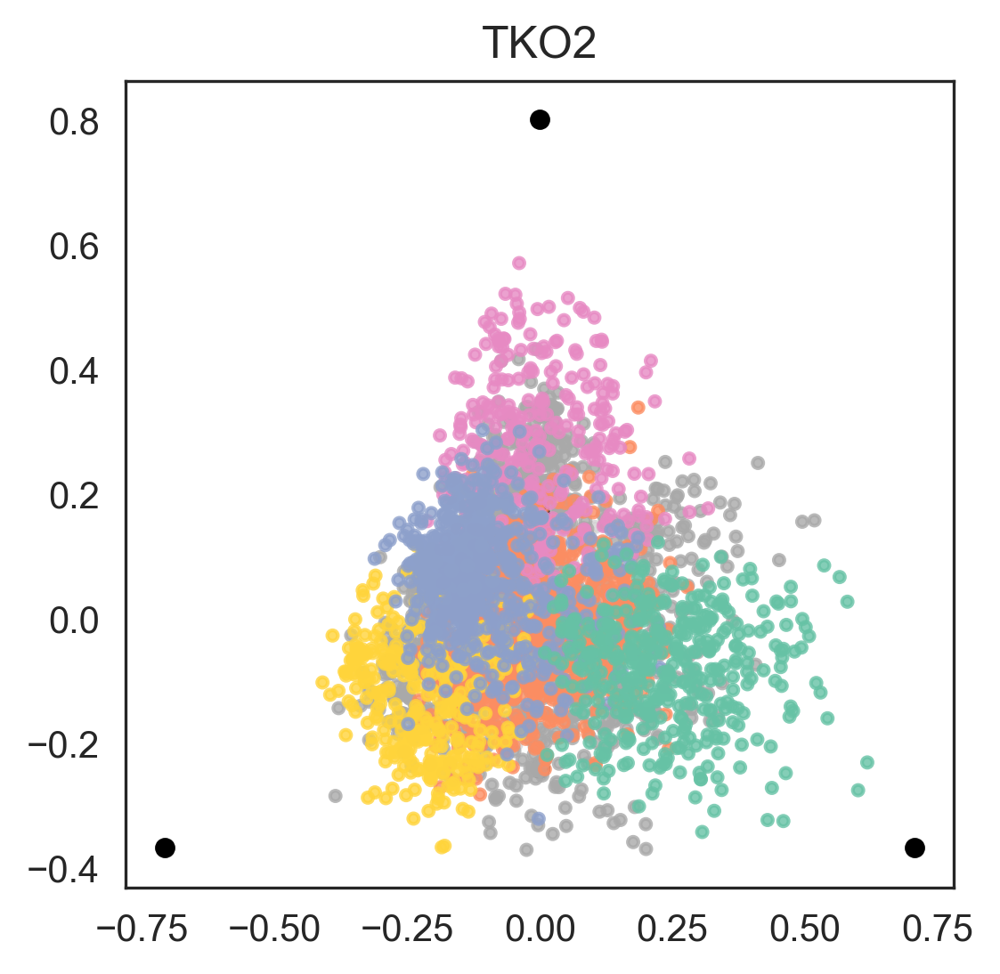

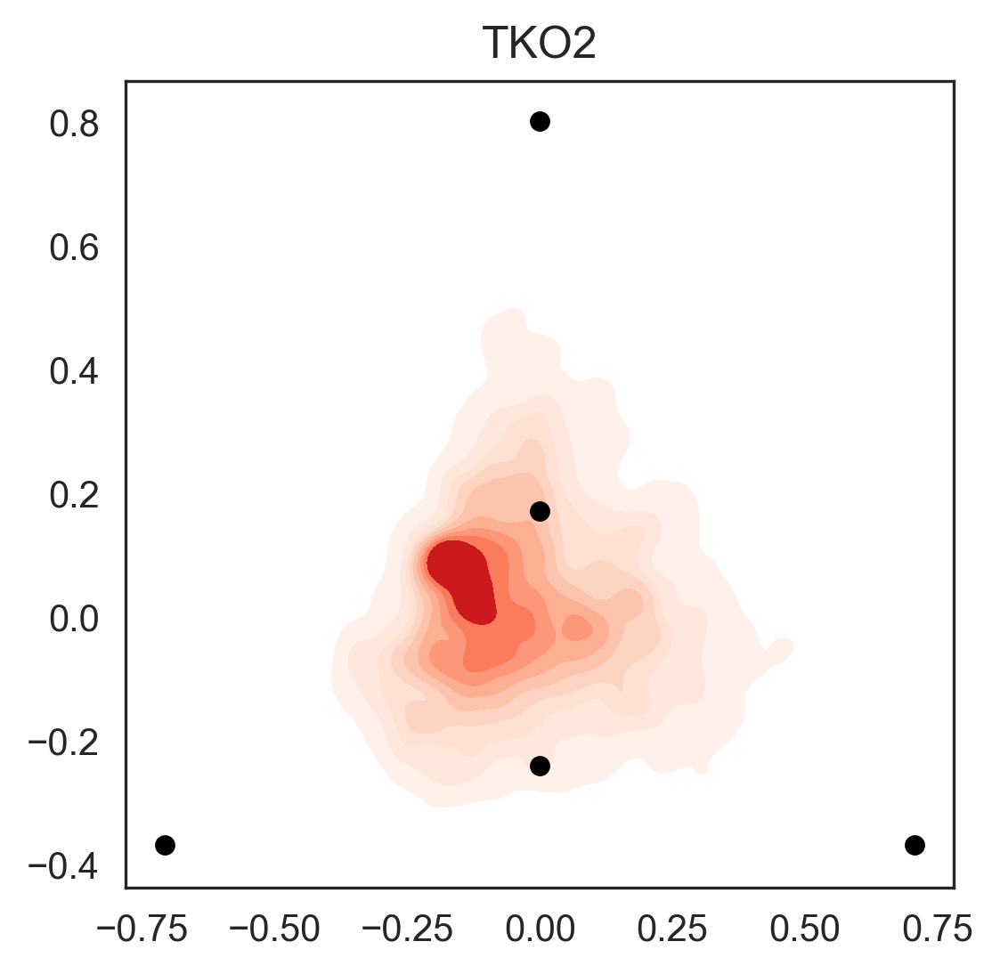

TKO3
Index(['SCLC-P_Score', 'SCLC-A_Score', 'SCLC-Y_Score'], dtype='object')


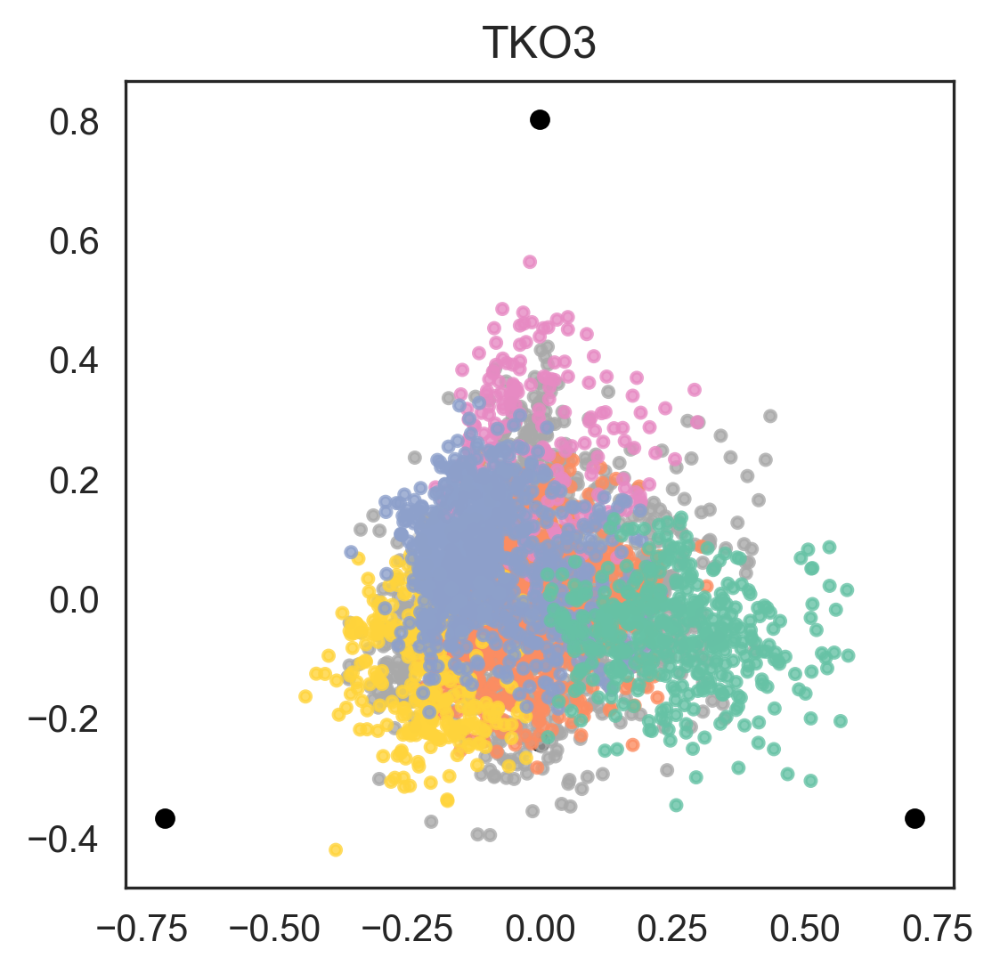

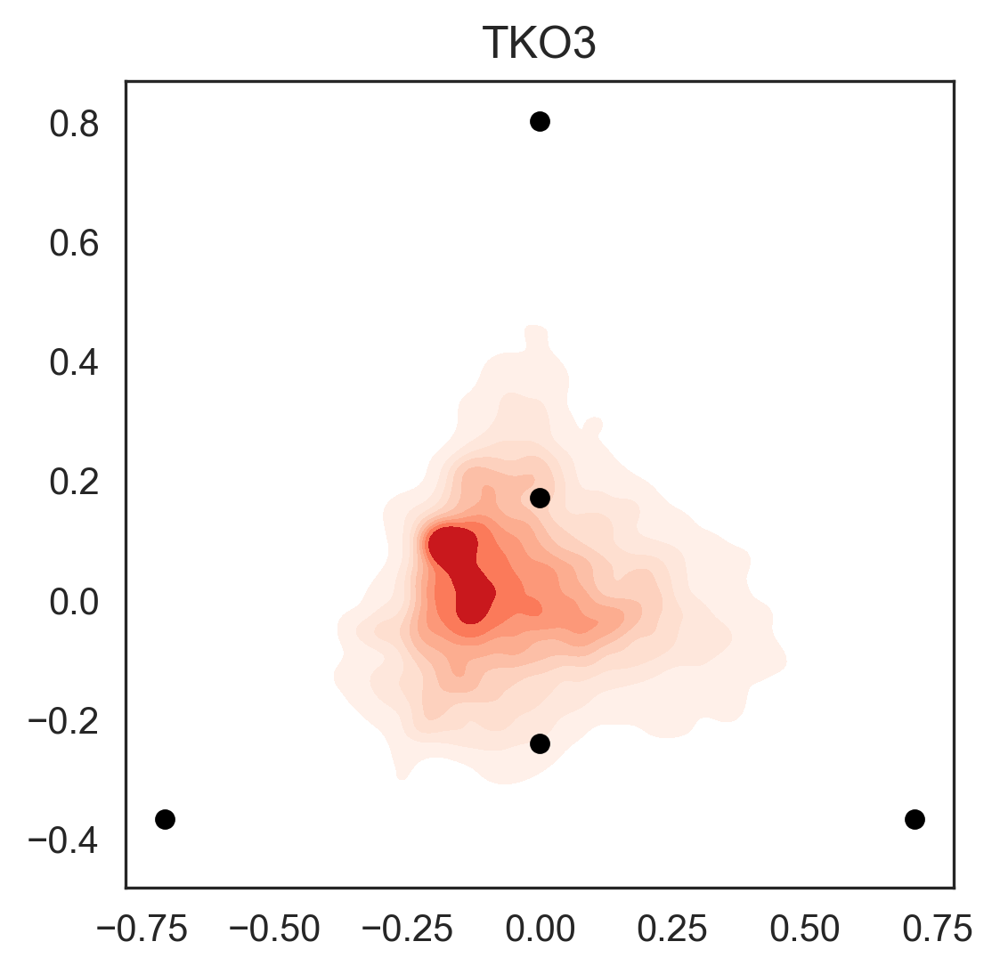

In [6]:
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y Specialist': cp[4], 'SCLC-A Specialist': cp[0], 'SCLC-A2 Specialist': cp[1], 'SCLC-N Specialist': cp[2], 'SCLC-P Specialist': cp[3],
              'Generalist': 'darkgrey', 'Unclassified': 'lightgrey'}
mb.pl.archetype_diagrams(adata, sig_matrix, color_dict=color_dict, groupby='tumor',color = 'arc_aa_type',
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',sizes = 20,
                        figsize=(4,4), score_name = '_Score', alpha = .8, s = 8, arrows = False, density = True)


In [22]:
adata.write_h5ad('../int/tko/adata05.h5ad')

... storing 'Phenotype' as categorical
... storing 'Phenotype_extended' as categorical
... storing 'arc_pheno' as categorical
... storing 'arc_aa_type' as categorical


In [2]:
adata = sc.read_h5ad('../int/tko/adata05.h5ad')

# Comparing CTrP to subtypes

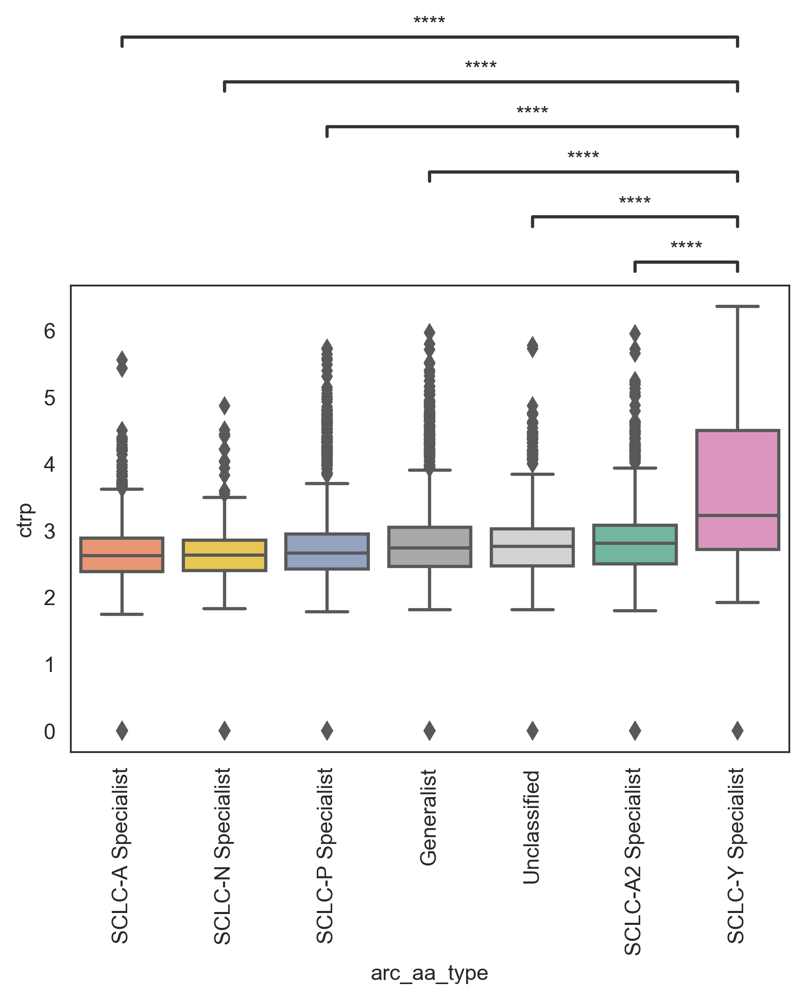

In [12]:
from statannot import add_stat_annotation
cp = ['#a9a9a9','#d3d3d3','#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3'] #for use with generalists, etc.
plt.figure(figsize=(6,4))
df = adata.obs[['arc_aa_type','ctrp']].pivot(columns='arc_aa_type')
df.columns = df.columns.droplevel(0)
sorted_index = df.median().sort_values().index

ax = sns.boxplot(data = adata.obs, x='arc_aa_type',y = 'ctrp',palette =[cp[2],cp[4],cp[5],cp[0],cp[1],cp[3],cp[6],], order = sorted_index)
#                 order = sorted(list(set(adata.obs['arc_aa_type']))))
add_stat_annotation(ax, data=adata.obs, x='arc_aa_type',y = 'ctrp',
#                     order = sorted(list(set(adata.obs['arc_aa_type']))),
                    order = sorted_index,
                    box_pairs=[('SCLC-Y Specialist','Unclassified'),
                              ('SCLC-Y Specialist','SCLC-A Specialist'), ("SCLC-Y Specialist", "SCLC-A2 Specialist"),("SCLC-Y Specialist", "SCLC-N Specialist"),
                               ("SCLC-Y Specialist", "SCLC-P Specialist"),
                              ("Generalist", "SCLC-Y Specialist")],
                    test='Mann-Whitney', text_format='star', loc='outside', verbose=0)
plt.xticks(rotation = 90)
plt.savefig('./figures/tko/ctrp_by aa_type.pdf')

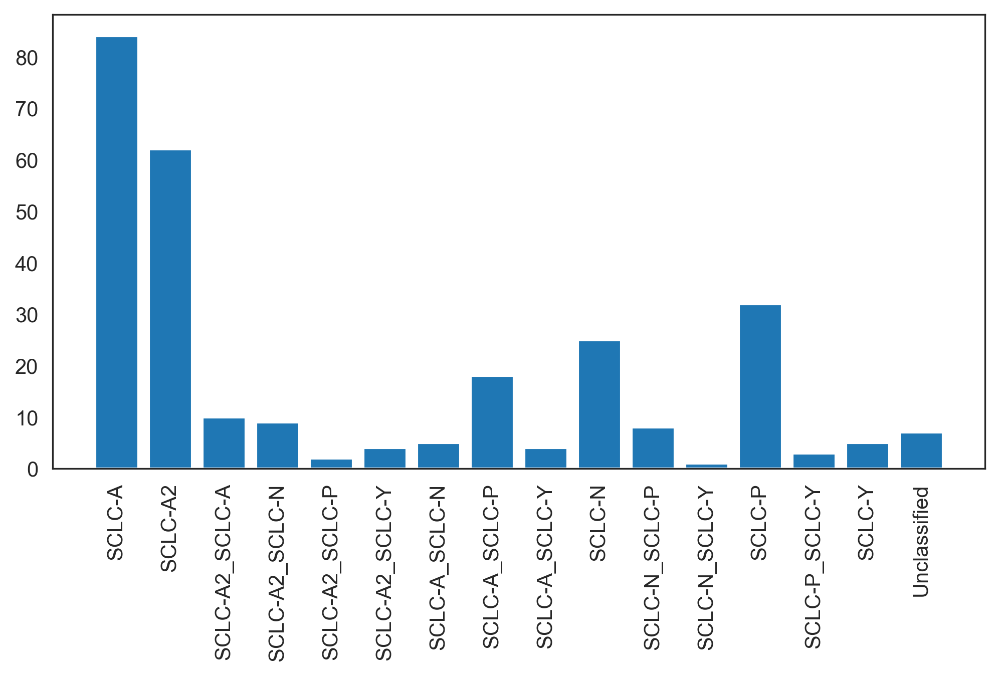

In [11]:
plt.bar(pd.crosstab(adata.obs['arc_pheno'], adata.obs['absorbing']).index, 
       pd.crosstab(adata.obs['arc_pheno'], adata.obs['absorbing'])['True'])
plt.xticks(rotation = 90)
plt.savefig('./figures/tko/absorbing_barplot_arc-pheno.pdf')

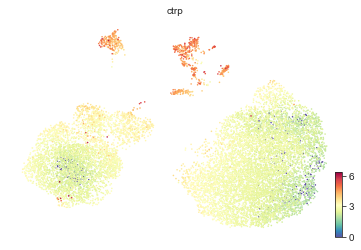

In [8]:
scv.pl.umap(adata, color = 'ctrp', cmap = 'Spectral_r')

In [10]:
arc_p = []
for i,r in adata.obs.iterrows():
    if r['arc_aa_type']=='Generalist':
        arc_p.append(r['arc_aa_type'])
    elif r['arc_aa_type'] == 'Unclassified':
        arc_p.append('None')
    else:
        arc_p.append(r['arc_aa_type'].split(" ")[0])

In [11]:
adata.obs['arc_pheno_for_diagrams'] = arc_p

In [14]:
from sklearn.manifold import LocallyLinearEmbedding
cp = ['#a9a9a9','#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3', '#d3d3d3'] #for use with generalists, etc.

color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}

groupby = 'None'
color = "arc_pheno_for_diagrams",
order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2']
norm = 'None'
multiplier=1
figsize=(12,12)
score_name = '_Score'
n_types = len(sig_matrix.columns)
subtypes = sig_matrix.columns

X = adata.obs[[f"{x}{score_name}" for x in subtypes]]
X_t1 = adata.obs[[f"{x}{score_name}_t1" for x in subtypes]]
top = X.sum().sort_values(ascending=False)[:3]  # return a list of n largest element
print(top.index)


X = X.fillna(0)
X_t1 = X_t1.fillna(0)
#Order of sig_matrix, or specified order, for plotting vertices
if type(order) != type(None):
    X = X[[f"{x}{score_name}" for x in order]]
    X_t1 = X_t1[[f"{x}{score_name}_t1" for x in order]]
    subtypes = order
else:
    order = subtypes

ident = np.identity(n_types)

for i, x in enumerate(subtypes):
    X = X.append(pd.DataFrame(np.array(ident[i]), index=X.columns, columns=[x]).T)

embedding = LocallyLinearEmbedding(n_components=2, n_neighbors=4, method='modified', eigen_solver='dense')
X_transformed = embedding.fit_transform(X[-n_types:]) #fit and transform vertcies (ident[i])
X_transformed = X_transformed.T

#transform data
X_df_data = embedding.transform(X[:-n_types])
X_df_data = X_df_data.T

X_t1 = embedding.transform(X_t1)
X_t1 = X_t1.T


Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


In [15]:
adata.obsm['X_LLE'] = X_df_data.T

saving figure to file ./figures/scvelo_tko_arc_digram_velocity_embedding_grid.pdf


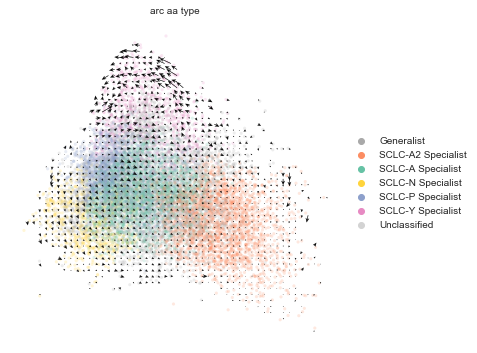

In [17]:
scv.pl.velocity_embedding_grid(adata, basis = 'LLE', color = 'arc_aa_type',figsize=(6,6), palette=cp, legend_loc = 'on right', save='tko_arc_digram_velocity_embedding_grid.pdf',
                              arrow_color='k', arrow_size = 2)
# plt.savefig()

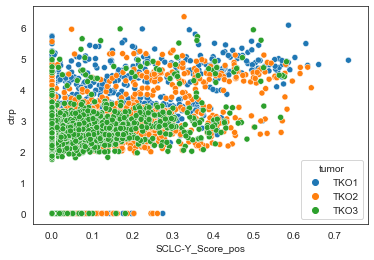

In [25]:
sns.scatterplot(adata.obs['SCLC-Y_Score_pos'], adata.obs['ctrp'], hue = adata.obs['tumor'])

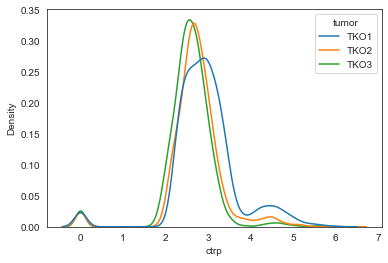

In [27]:
sns.kdeplot(adata.obs['ctrp'], hue = adata.obs['tumor'])

saving figure to file ./figures/scvelo_TKO1_ctrp_archetype_diagram.pdf


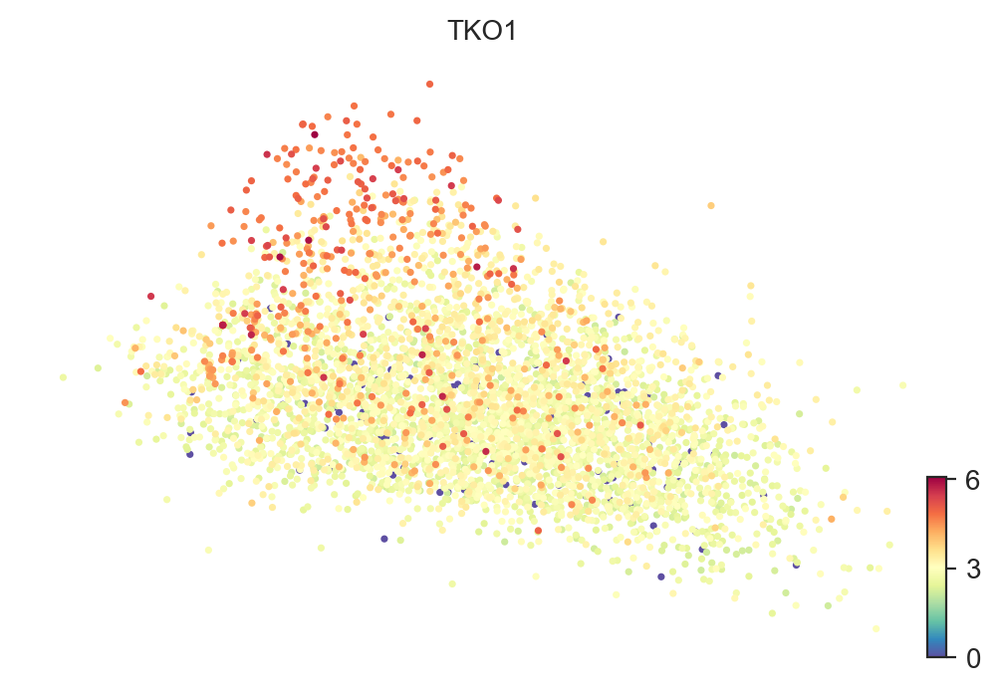

saving figure to file ./figures/scvelo_TKO2_ctrp_archetype_diagram.pdf


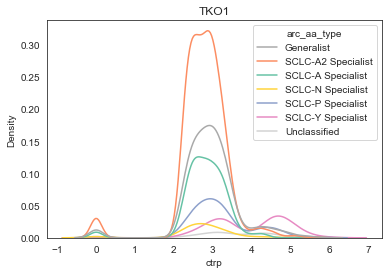

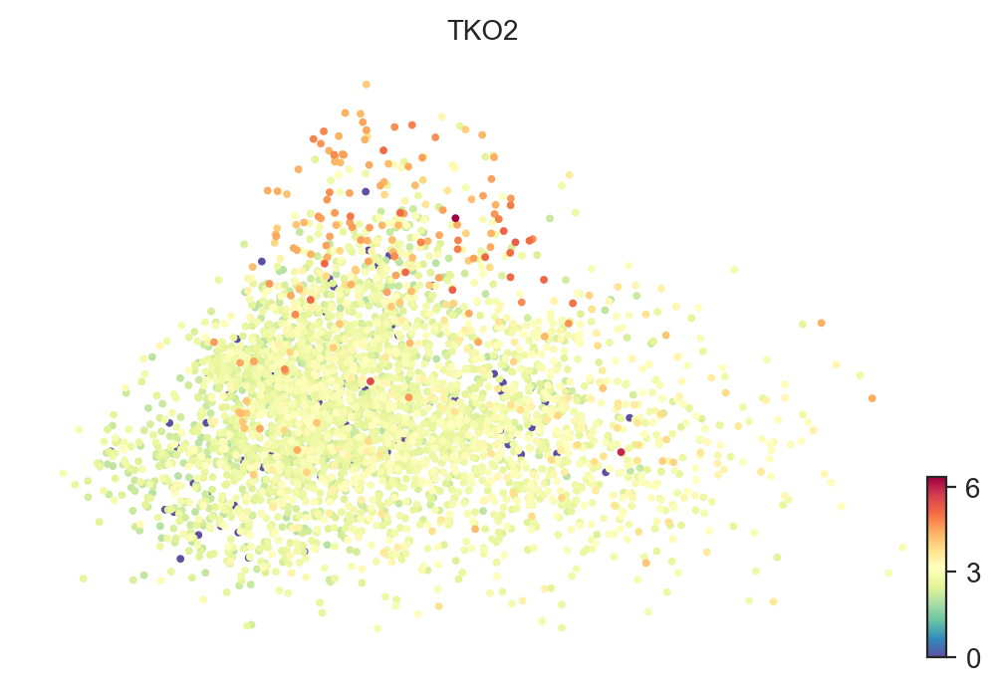

saving figure to file ./figures/scvelo_TKO3_ctrp_archetype_diagram.pdf


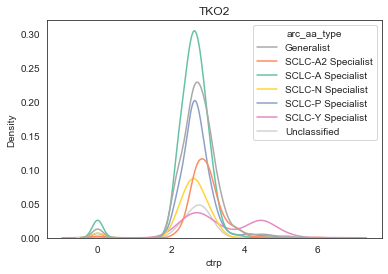

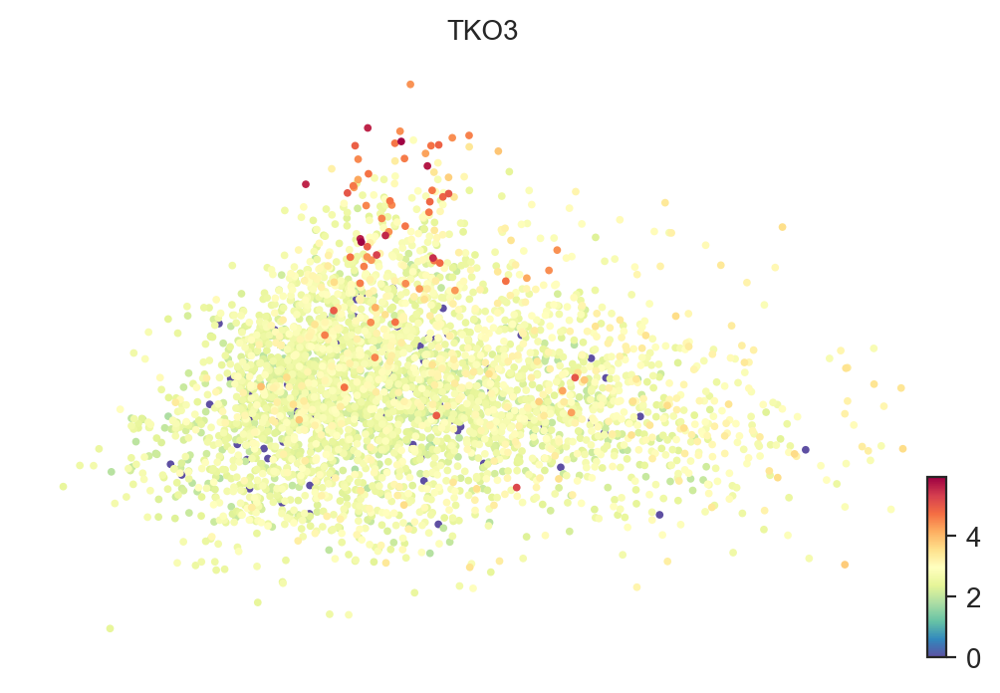

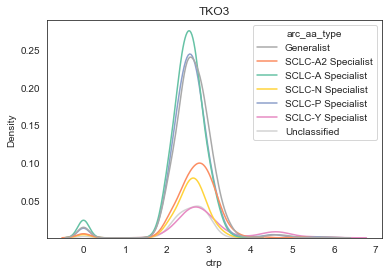

In [33]:
for cat in sorted(list(set(adata.obs['tumor']))):
    scv.pl.scatter(adata[adata.obs['tumor'] == cat], basis = 'LLE', color = 'ctrp', cmap = "Spectral_r", dpi= 200, title=cat, save=f'{cat}_ctrp_archetype_diagram.pdf')
    sns.kdeplot(adata[adata.obs['tumor'] == cat].obs['ctrp'], hue = adata[adata.obs['tumor'] == cat].obs['arc_aa_type'], palette=cp)
    plt.title(cat)
    plt.savefig(f"./figures/tko/{cat}_hist_ctrp.pdf")

## Doublets

In [20]:
mb.pp.doublet_detections(adata, layer = 'matrix')

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.46
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 31.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.4%
Elapsed time: 10.0 seconds


In [21]:
adata.obs.groupby('arc_aa_type').sum()['predicted_doublets']

arc_aa_type
Generalist            43
SCLC-A Specialist     41
SCLC-A2 Specialist    37
SCLC-N Specialist     11
SCLC-P Specialist     12
SCLC-Y Specialist     18
Unclassified           7
Name: predicted_doublets, dtype: int64

# Unused analyses

## phenotyping unused

In [119]:
import mazebox as mb
import scvelo as scv
import scanpy as sc
import os.path as op
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
adata = sc.read_h5ad('../int/tko/adata04.h5ad')
sig_matrix = pd.read_csv('../data/sig_matrix_ParTI.csv', header =0, index_col = 0)
sig_matrix = sig_matrix / np.linalg.norm(sig_matrix, axis=0)
ind = []
for i in sig_matrix.index:
    ind.append(i.capitalize())
sig_matrix.index = ind


In [34]:
arc_genes = pd.read_csv('../data/arc_gene_space_no_lowgenes.csv', header=None)

In [38]:
genes = pd.read_csv('../data/geneNames_wo_lowgenes.csv', header = None)
genes

,0
0,A1BG
1,A1CF
2,A2M
3,A2ML1
4,A4GALT
...,...
15945,ZYG11A
15946,ZYG11B
15947,ZYX
15948,ZZEF1


In [39]:
arc_genes.columns = genes[0]

In [45]:
arc_genes.index = ['SCLC-Y', 'SCLC-P', 'SCLC-N', 'SCLC-A2', 'SCLC-A']

In [50]:
arc_high = arc_genes.T.loc[arc_genes.max()>4]

In [58]:
arc = arc_high.loc[arc_high.T.var()>1]

In [76]:
arc = arc[['SCLC-A','SCLC-A2','SCLC-N','SCLC-P','SCLC-Y']]

In [64]:
arc = arc / np.linalg.norm(arc, axis=0)
ind = []
for i in arc.index:
    ind.append(i.capitalize())
arc.index = ind

In [101]:
arc.to_csv('../int/arc_high_genes.csv')

In [120]:
outdir_ = './out/'

data, sig_matrix1, adata_small, lanorm = mb.ar.transform_tumor_space(adata, arc, unlog=False, scale=False, type = None)


        # Transform velocity vectors
data_vel, sig_matrix2, adata_small = mb.ar.transform_vel(adata_small, sig_matrix1, scale=False, lanorm=lanorm)

# # Plot tumor data with velocity in cell type space
# for clust in range(4):
#     mb.pl.twodimplot_tumor(data=data,veldata= data_vel,adata= adata_small,gene_sig= sig_matrix2, celltype1 = clust, celltype2 = clust+1,
#                      save = False, dir_prefix = outdir_,
#                      tumor_clust_name='timepoint')
#     mb.pl.twodimplot_tumor(data=data, veldata=data_vel, adata=adata_small, gene_sig=sig_matrix2, celltype1=clust, celltype2=clust + 1,
#                      save=False, dir_prefix=outdir_,
#                      meanonly = True, tumor_clust_name='timepoint')



Transforming tumor data...
Gene signature matrix now has shape:  (1246, 5)
Tumor data shortened to genes in gene list...


Trying to set attribute `.obs` of view, copying.


(12197, 1246)
Tumor data subsetting complete.


In [3]:
#  mb.pl.twodimplot_tumor(data=data,veldata= data_vel,adata= adata_small,gene_sig= sig_matrix2, celltype1 = 2, celltype2 = 4,
#                      save = False, dir_prefix = outdir_, meanonly = True,
#                      tumor_clust_name='timepoint')

In [121]:
data.index = adata_small.obs_names
data.columns = sig_matrix.columns
for s in data:
    adata_small.obs[f"{s}_Score"] = data[s]
data_vel.index = adata_small.obs_names
data_vel.columns = sig_matrix.columns
for s in data_vel:
    adata_small.obs[f"{s}_Score_t1"] = data_vel[s] + data[s]
    

In [122]:
adata_small.obs['tumor'] = adata_small.obs['tumor'].astype('category')


In [133]:
#filtered phenotype
pheno = []

for i,r in data.iterrows():
    test = r*(r>0)
#     if test.max() < .1: pheno.append('None')

#     elif test.max()>.5:
# #     if (test/test.sum()).max()>.9:
    pheno.append(data.columns[test.argmax()])
#     else: pheno.append('Generalist')
adata_small.obs['Phenotype'] = pheno


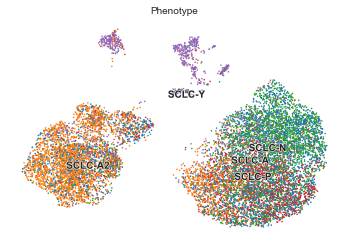

In [134]:
scv.pl.scatter(adata_small, basis = 'umap', color = 'Phenotype')

<AxesSubplot:xlabel='leiden', ylabel='SCLC-A_Score'>

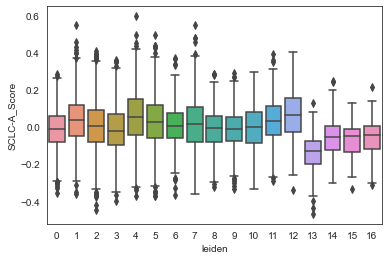

In [94]:
sns.boxplot(data= adata_small.obs, x='leiden', y = 'SCLC-A_Score')

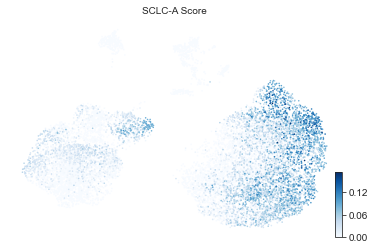

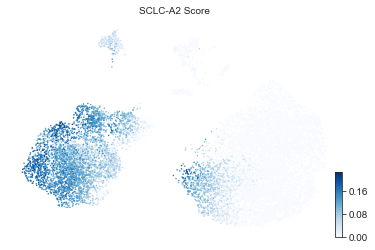

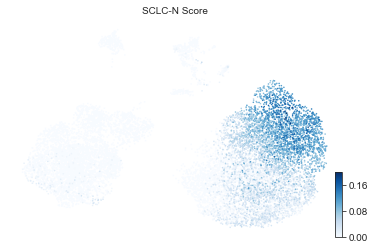

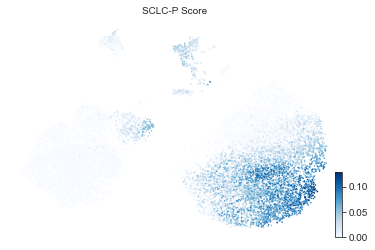

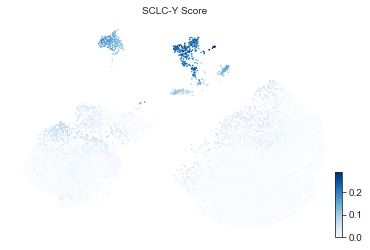

In [128]:
scv.pl.scatter(adata_small, basis = 'umap', color = 'SCLC-A_Score', vmin = 0, smooth = True, color_map='Blues')
scv.pl.scatter(adata_small, basis = 'umap', color = 'SCLC-A2_Score', vmin = 0, smooth = True, color_map='Blues')
scv.pl.scatter(adata_small, basis = 'umap', color = 'SCLC-N_Score', vmin = 0, smooth = True, color_map='Blues')
scv.pl.scatter(adata_small, basis = 'umap', color = 'SCLC-P_Score', vmin = 0, smooth = True, color_map='Blues')
scv.pl.scatter(adata_small, basis = 'umap', color = 'SCLC-Y_Score', vmin = 0, smooth = True, color_map='Blues')

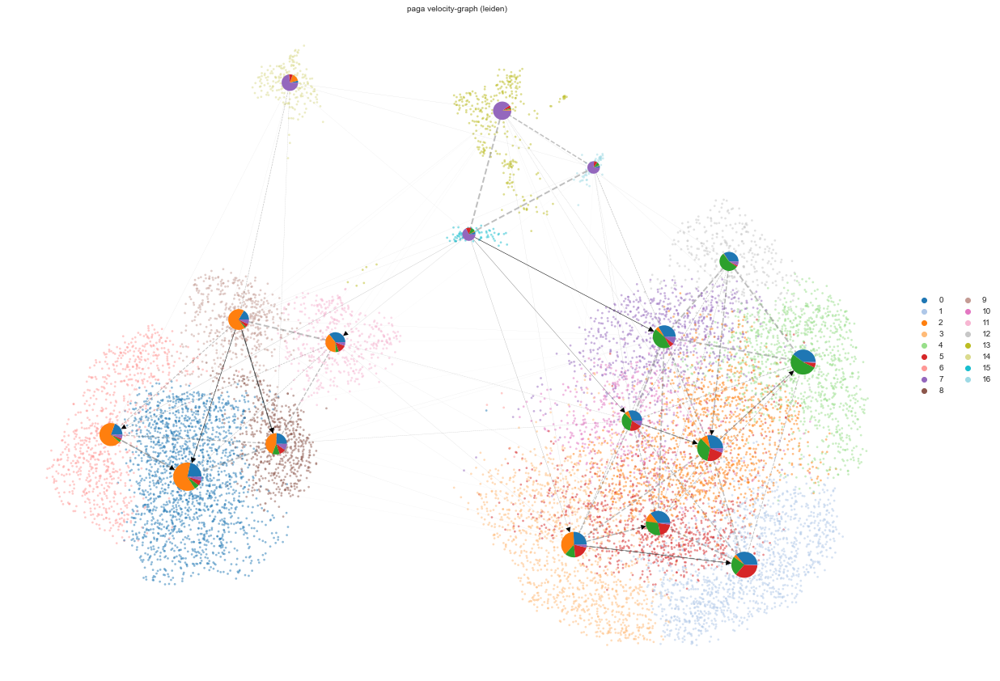

In [142]:
plt.rcParams["figure.figsize"] = (20,15)

scv.pl.paga(adata_small,basis = 'umap', color = 'Phenotype', node_size_scale = 5, size = 30)



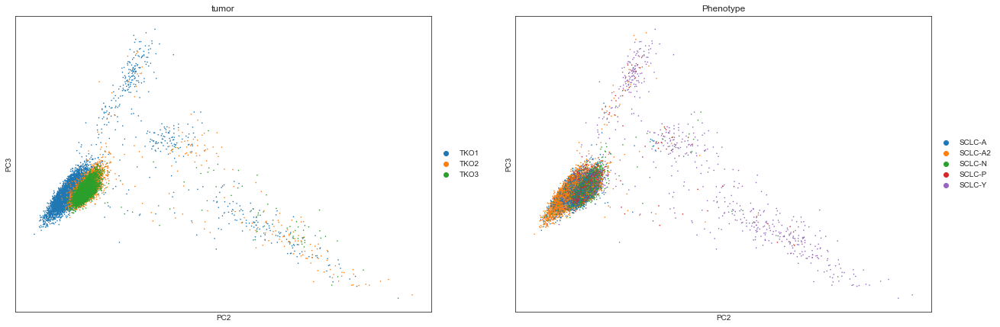

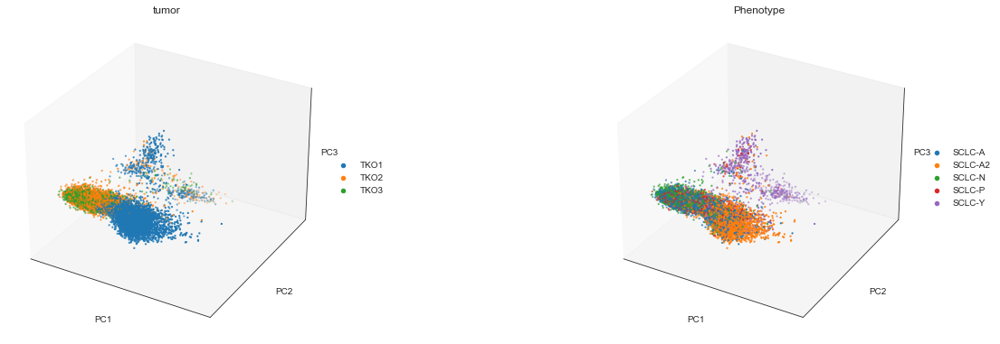

In [144]:
plt.rcParams["figure.figsize"] = (10,7)

sc.pl.pca(adata_small, color = ['tumor','Phenotype'], components=(2,3))
sc.pl.pca(adata_small, color = ['tumor','Phenotype'],projection='3d')


In [145]:
adata_small.obsm['X_pca'].shape

(12197, 50)

In [152]:
from py_pcha import PCHA
XC, S, C, SSE, varexpl = PCHA(adata_small.obsm['X_pca'].T, noc=4, delta=0.1)


In [153]:
XC.shape

(50, 4)

In [154]:
XC = np.array(XC)

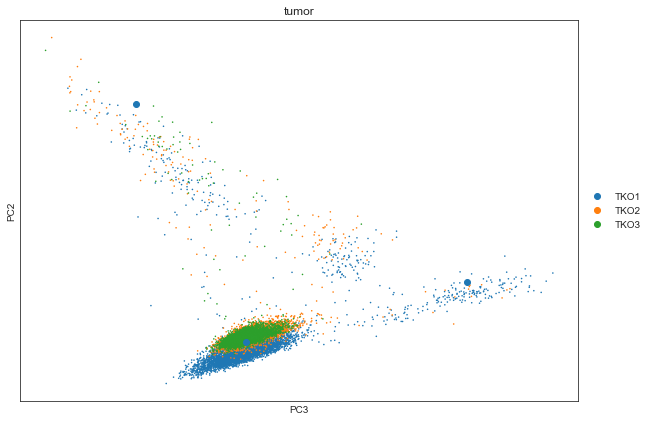

In [160]:
fig,ax = plt.subplots()
sc.pl.pca(adata_small, color = ['tumor'], ax=ax, components = (3,2),show=False)
ax.scatter(XC.T[:,2],XC.T[:,1])
plt.show()

Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


No handles with labels found to put in legend.


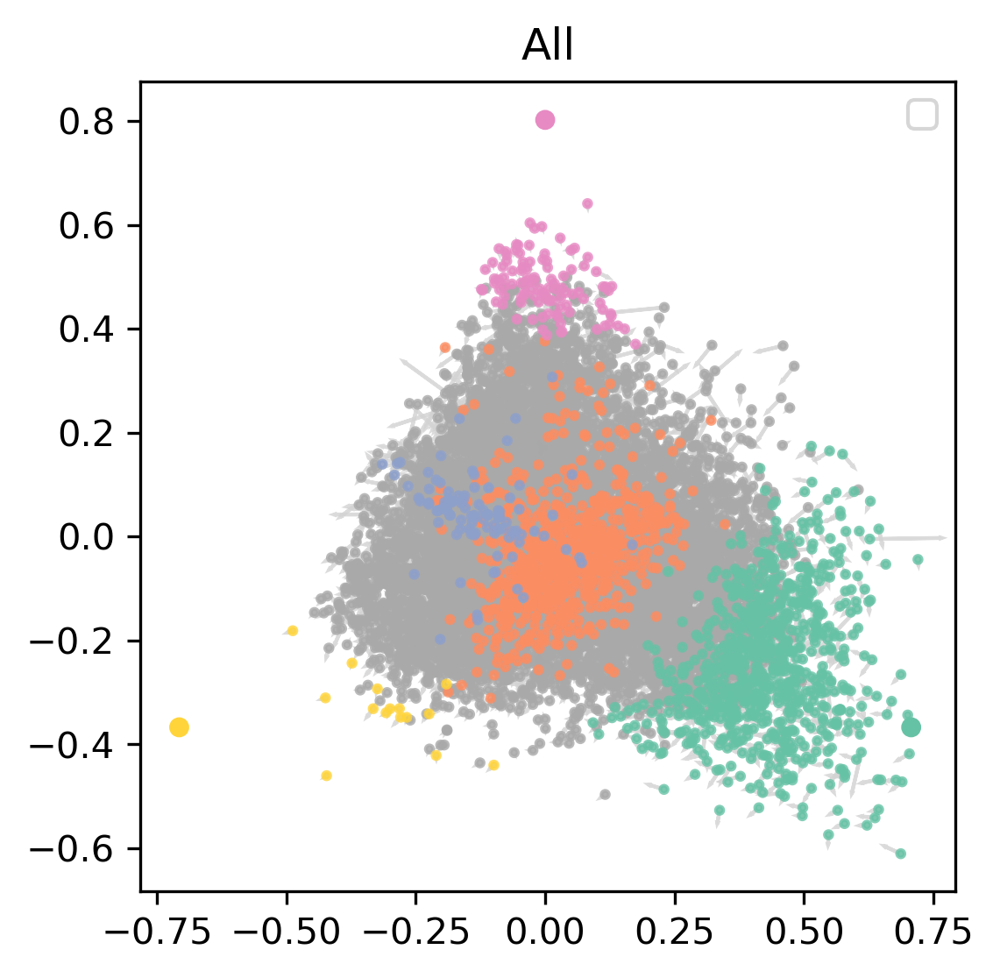

In [45]:
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='None',color='Phenotype',grid = False, mean_only = False,
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 40,
                        multiplier=1, figsize=(4,4), score_name = '_Score', alpha = .8, s = 4, sizes = 20, arrows = True)



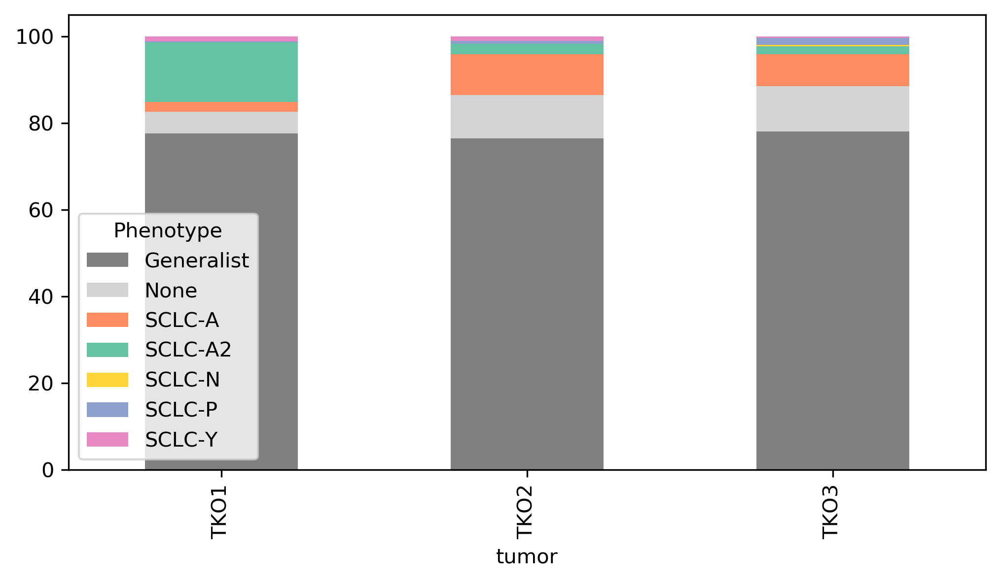

In [46]:
mb.pl.subtype_bar(adata_small,groupby='tumor', fname = 'tko', pheno_name="Phenotype")


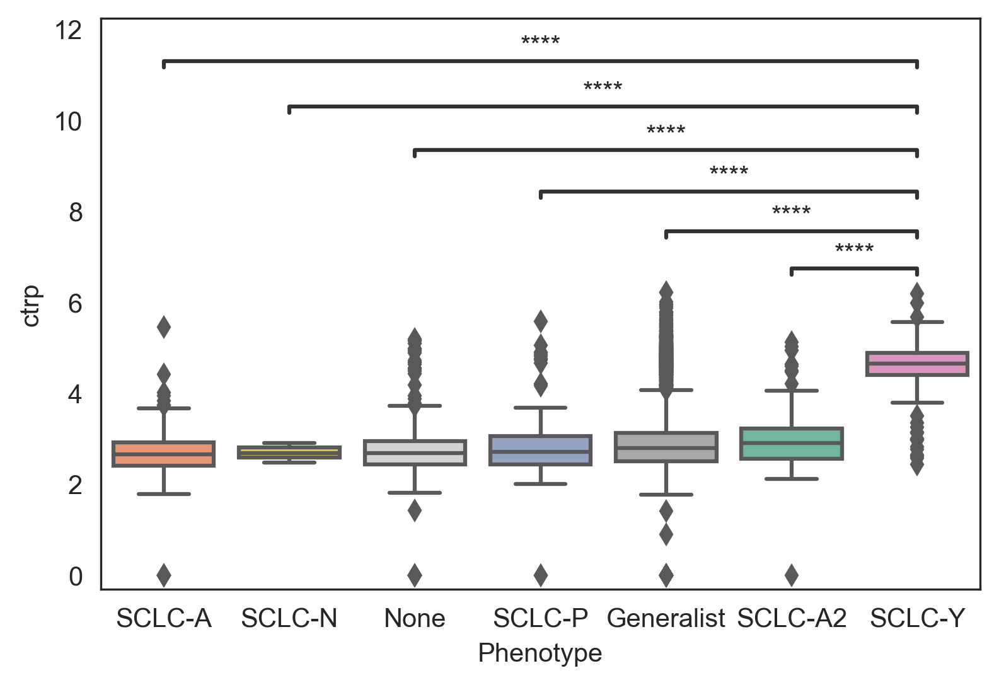

In [59]:
from statannot import add_stat_annotation
cp = ['#a9a9a9','#d3d3d3','#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
df = adata_small.obs[['Phenotype','ctrp']].pivot(columns='Phenotype')
df.columns = df.columns.droplevel(0)
sorted_index = df.mean().sort_values().index
plt.figure(figsize=(6,4))
ax = sns.boxplot(data = adata_small.obs, x='Phenotype',y = 'ctrp',palette=[cp[2],cp[4],cp[1],cp[5],cp[0],cp[3],cp[6]],
                order = sorted_index)
add_stat_annotation(ax, data=adata_small.obs, x='Phenotype',y = 'ctrp',
                    order = sorted_index,
                    box_pairs=[('SCLC-Y','None'),
                              ('SCLC-Y','SCLC-A'), ("SCLC-Y", "SCLC-A2"),
                               ("SCLC-Y", "SCLC-N"),("SCLC-Y", "SCLC-P"),
                              ("Generalist", "SCLC-Y")],
                    test='Mann-Whitney', text_format='star', loc='inside', verbose=0)
plt.savefig('./figures/ctrp_tko_phenotype.pdf')


Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


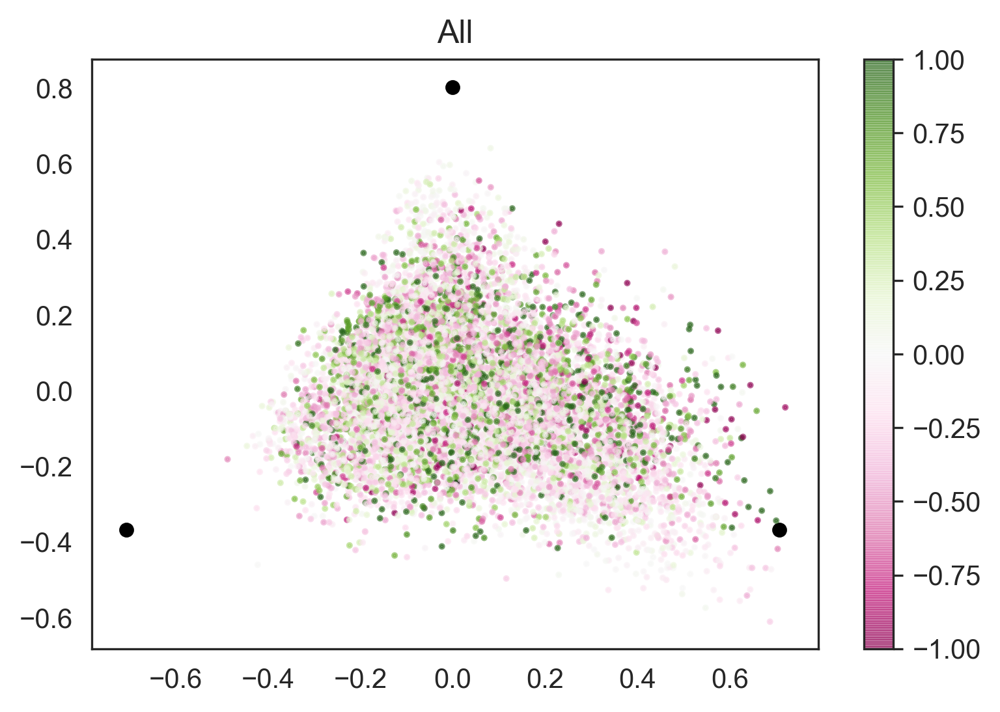

In [7]:
 import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
adata_small.obs['phase_score'] = adata_small.obs['G2M_score'] - adata_small.obs['S_score']
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='None',color='phase_score',grid = False,
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 40,cmap = 'PiYG',
                        multiplier=1, figsize=(6,4), score_name = '_Score', alpha = .6, s = 2, sizes = 20)

Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


No handles with labels found to put in legend.


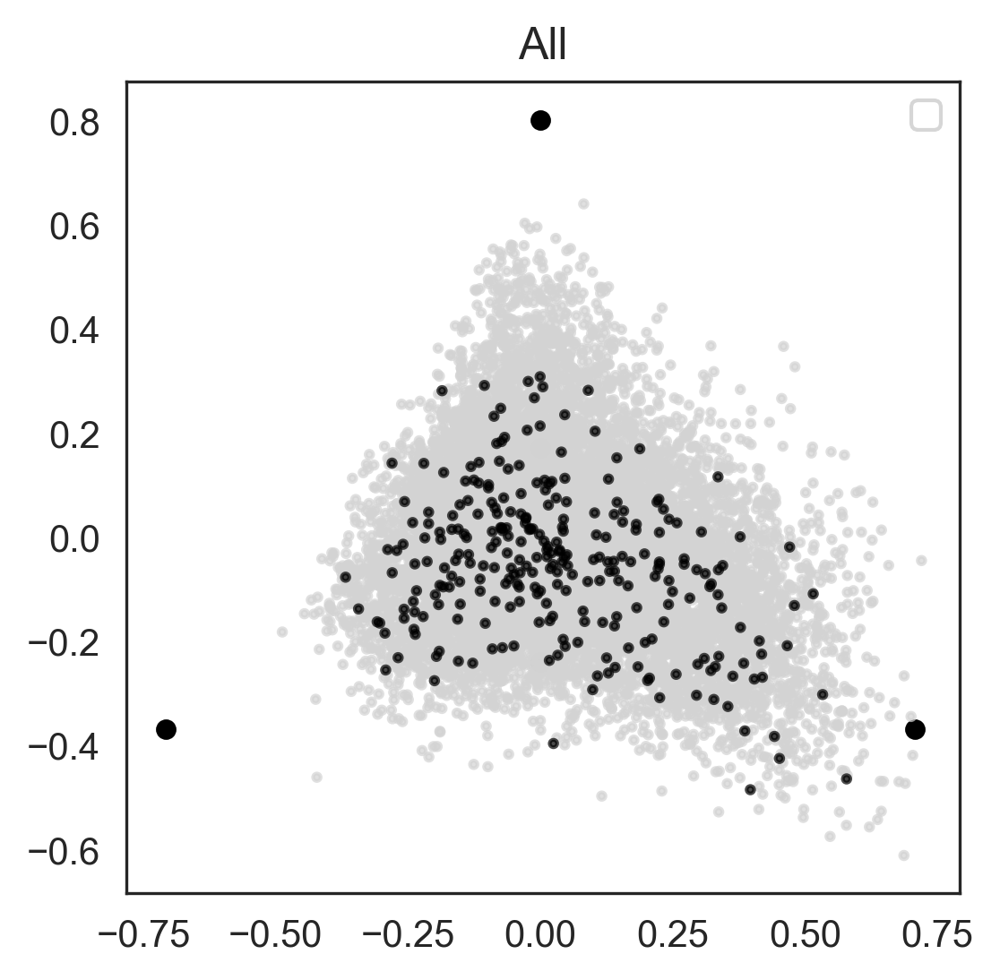

In [11]:
 import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
# color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
#               'Generalist': 'darkgray', 'None': 'lightgrey'}
color_dict = {'True':'black','False':'lightgrey'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='None',color='absorbing',grid = False,
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 40,cmap = 'Reds',
                        multiplier=1, figsize=(4,4), score_name = '_Score', alpha = .7, s = 4, sizes = 20)



Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


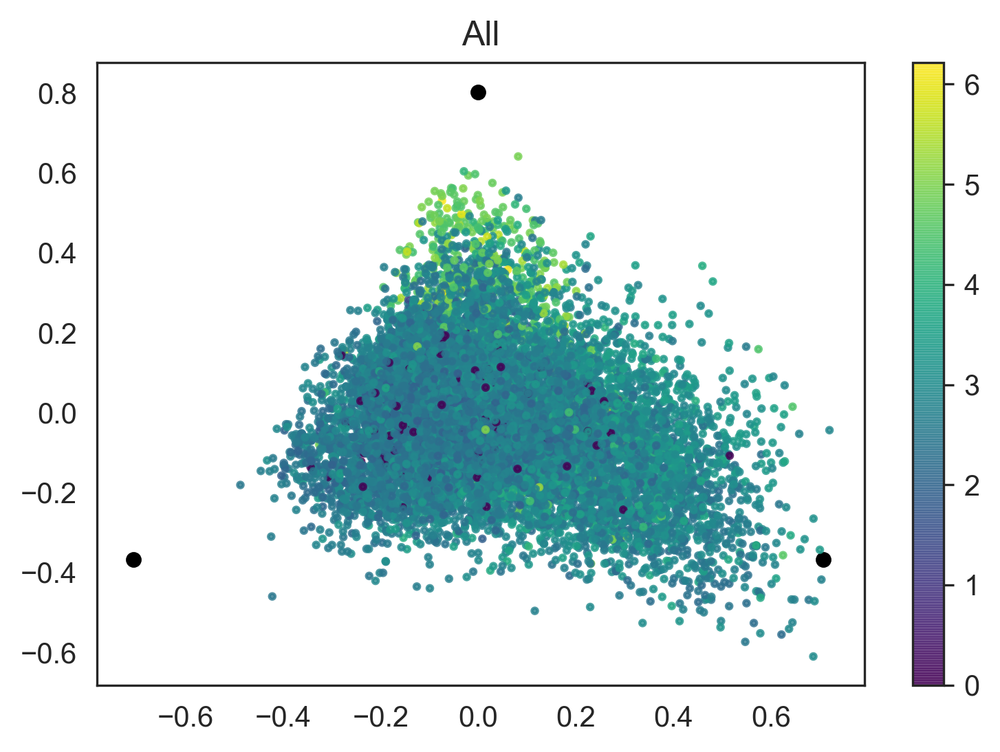

In [60]:
 import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='None',color='ctrp',grid = False,
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 40, vmax = None, vmin = None,
                        multiplier=1, figsize=(6,4), score_name = '_Score', alpha = .8, s = 4, sizes = 20)



TKO1
Index(['SCLC-A2_Score', 'SCLC-Y_Score', 'SCLC-N_Score'], dtype='object')


No handles with labels found to put in legend.


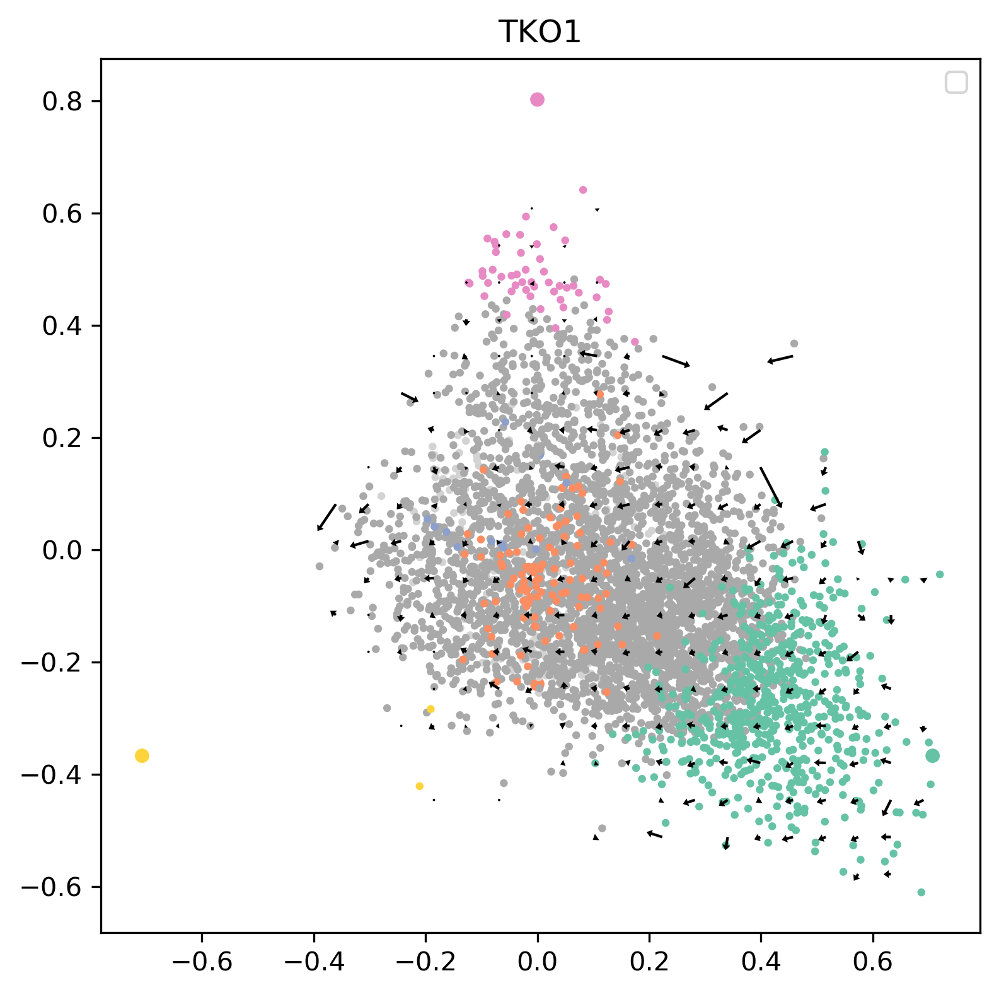

TKO2
Index(['SCLC-A_Score', 'SCLC-P_Score', 'SCLC-Y_Score'], dtype='object')


No handles with labels found to put in legend.


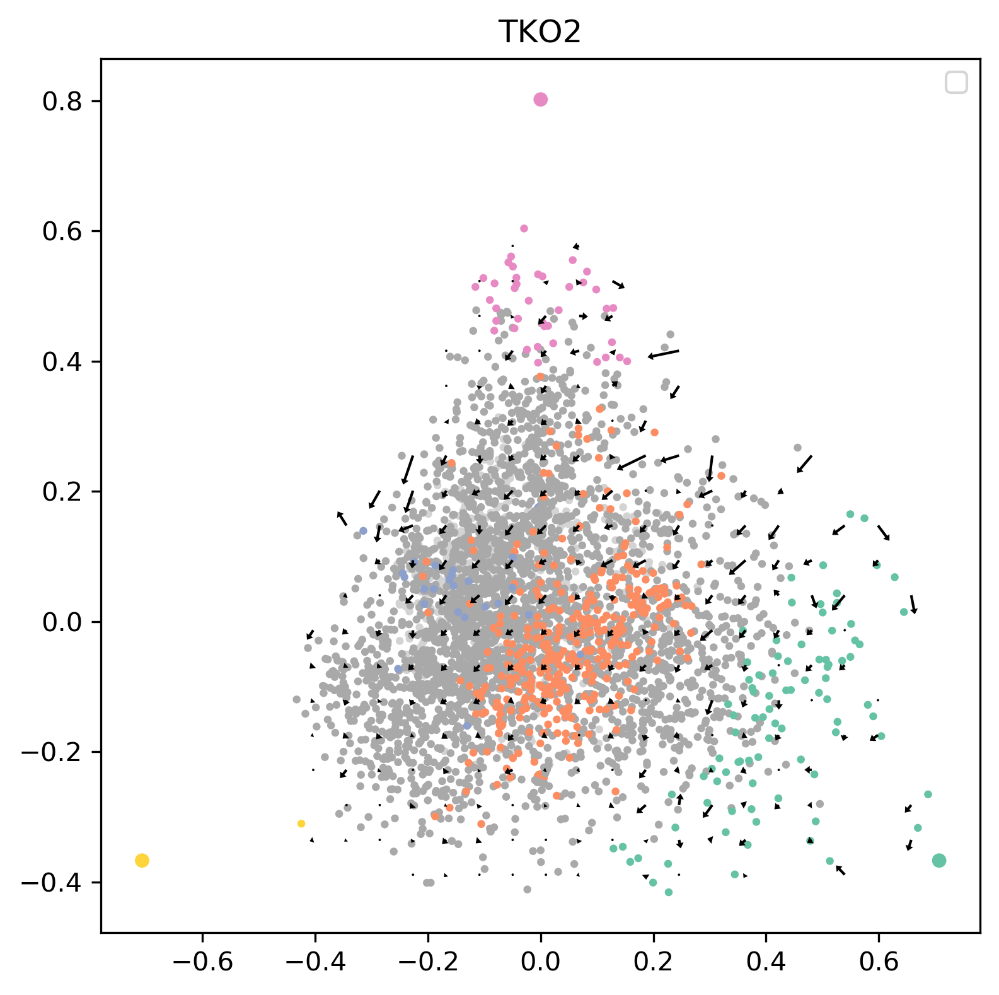

TKO3
Index(['SCLC-P_Score', 'SCLC-A_Score', 'SCLC-Y_Score'], dtype='object')


No handles with labels found to put in legend.


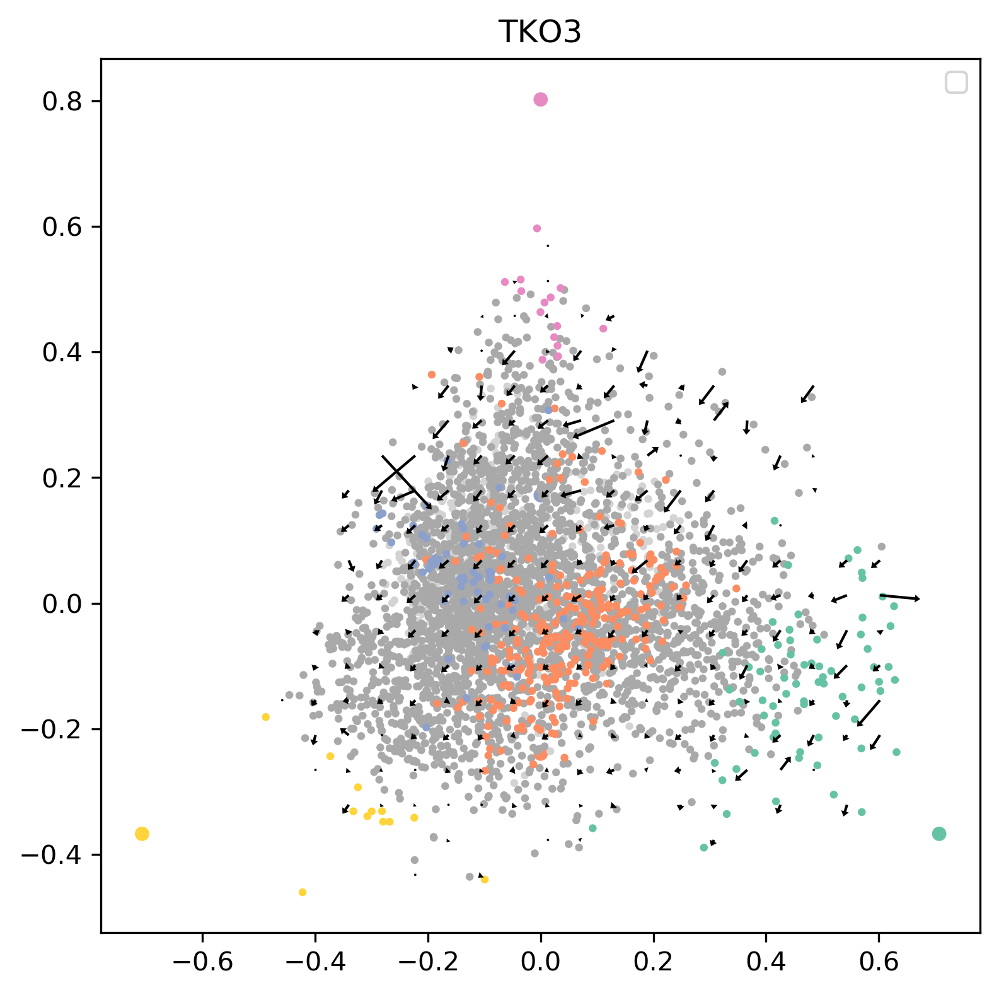

In [57]:
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='tumor',color='Phenotype',
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 20,
                        multiplier=1, figsize=(6,6), score_name = '_Score', alpha = 1, s = 4, sizes = 20, arrows = True)



0
Index(['SCLC-Y_Score', 'SCLC-P_Score', 'SCLC-A_Score'], dtype='object')


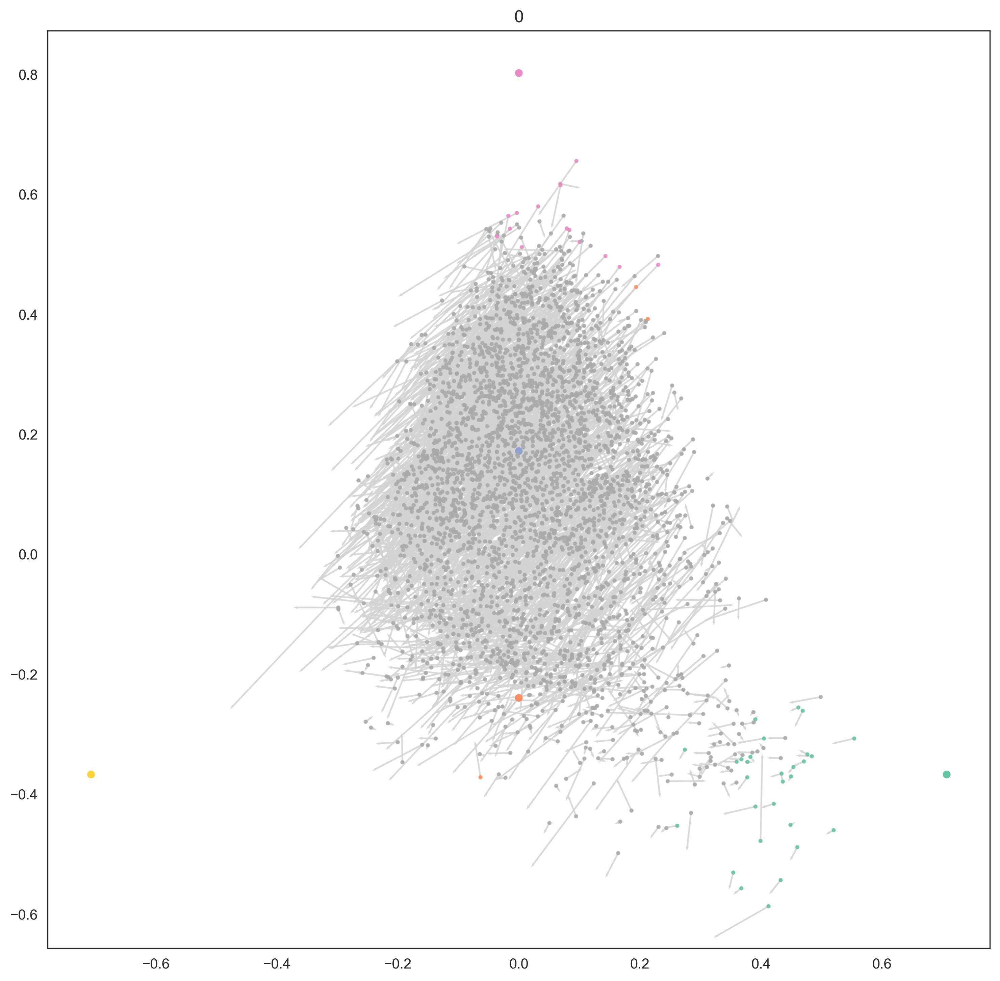

1
Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-P_Score'], dtype='object')


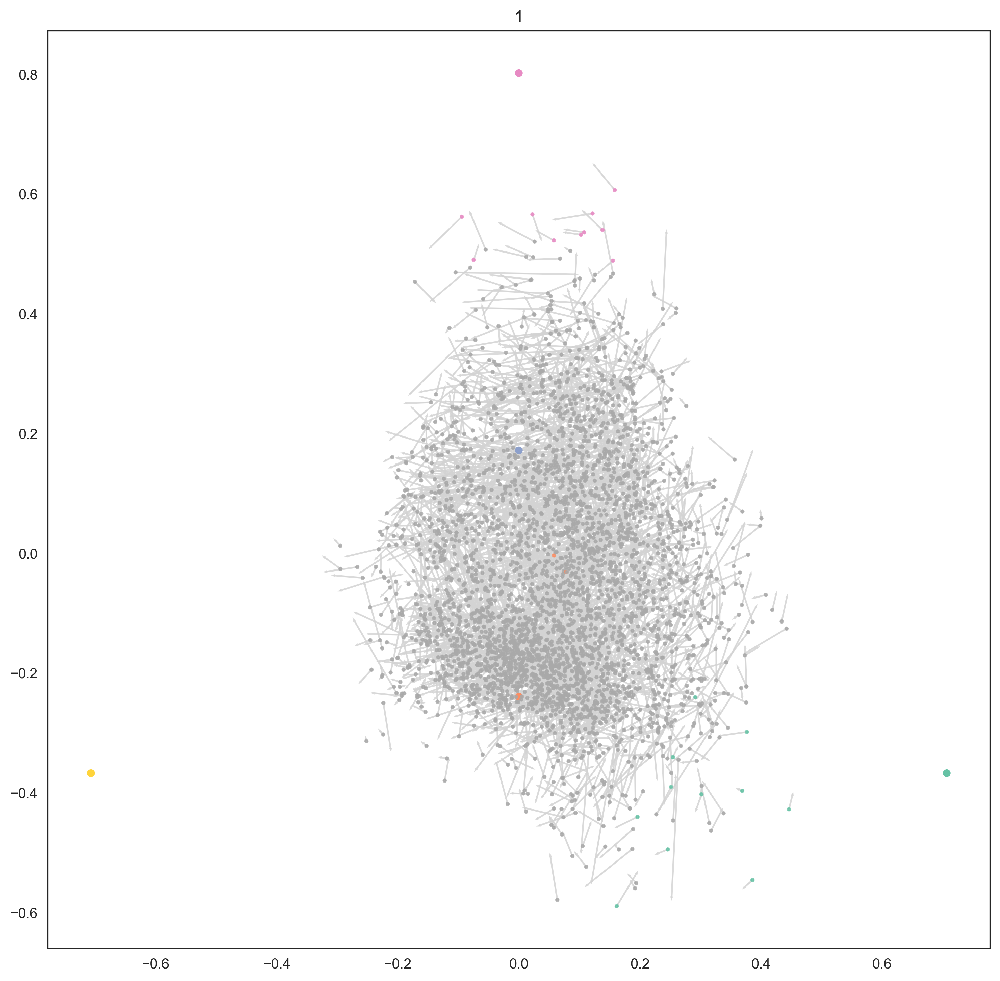

2
Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-P_Score'], dtype='object')


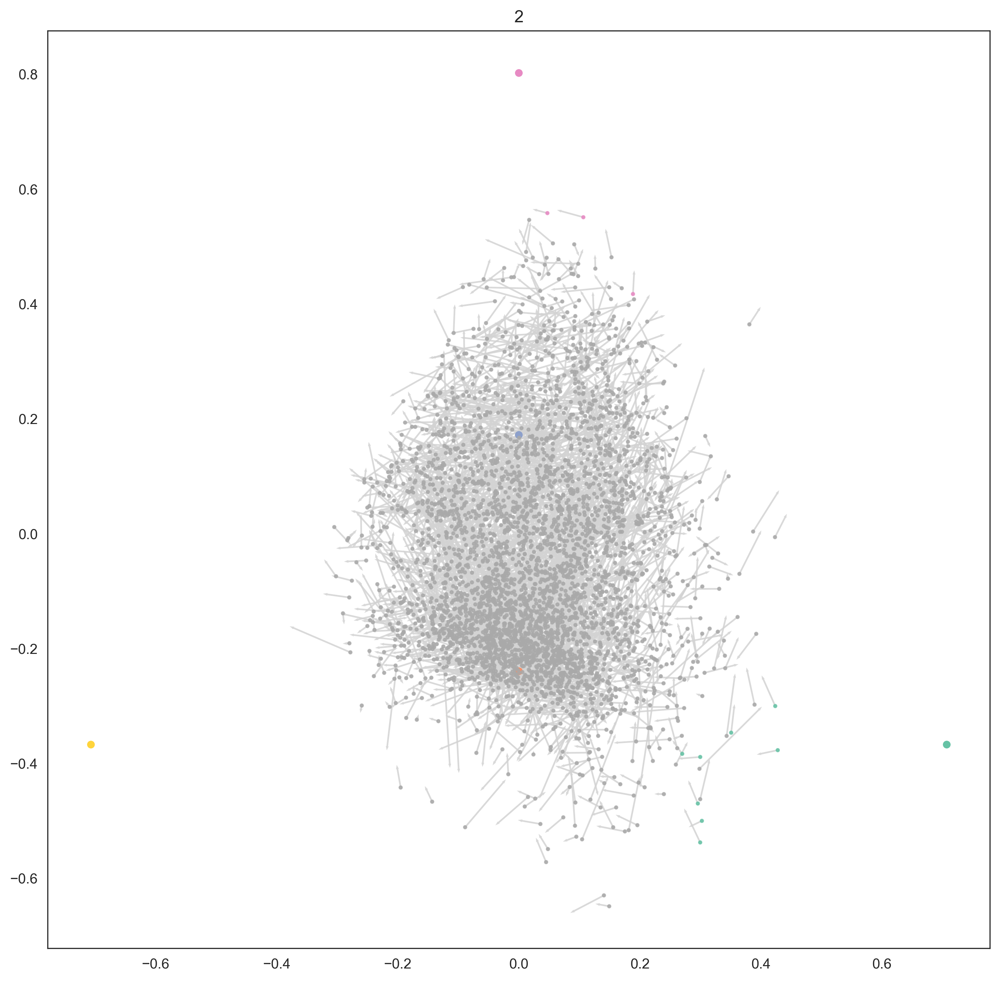

3
Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-P_Score'], dtype='object')


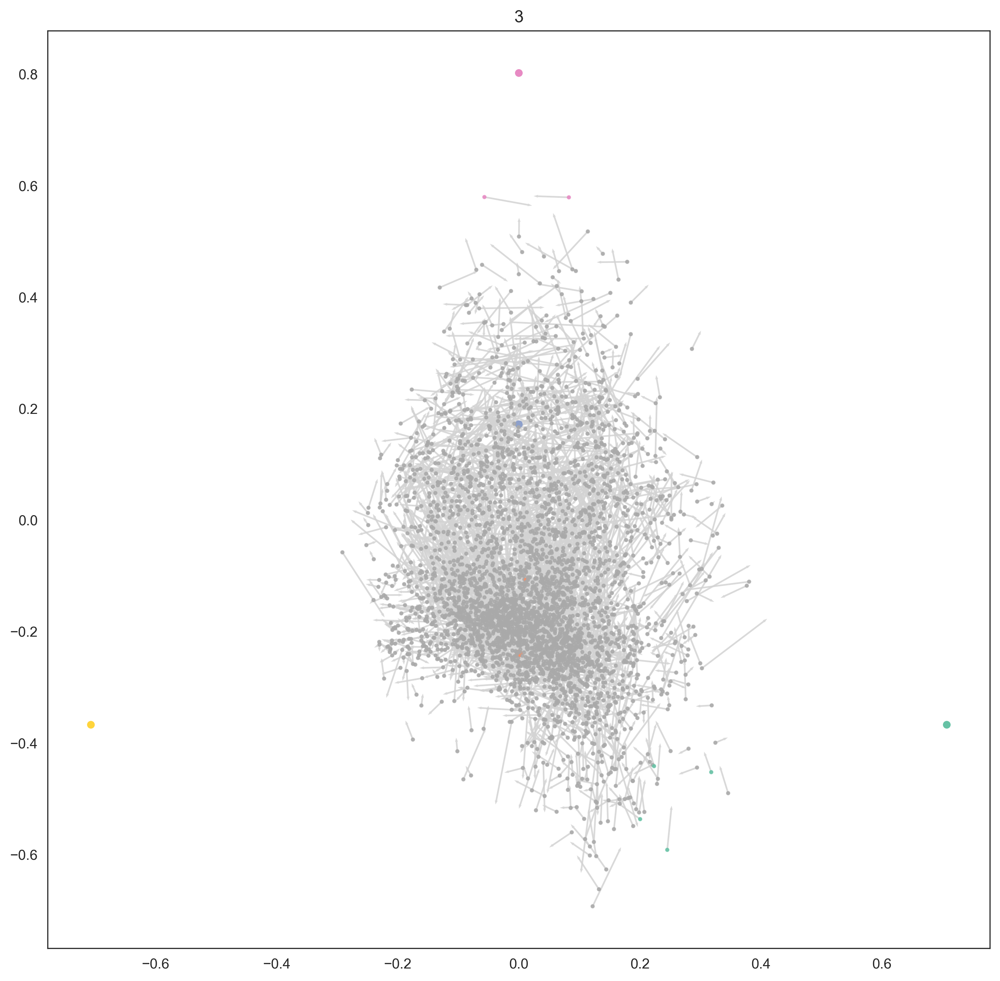

4
Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-A_Score'], dtype='object')


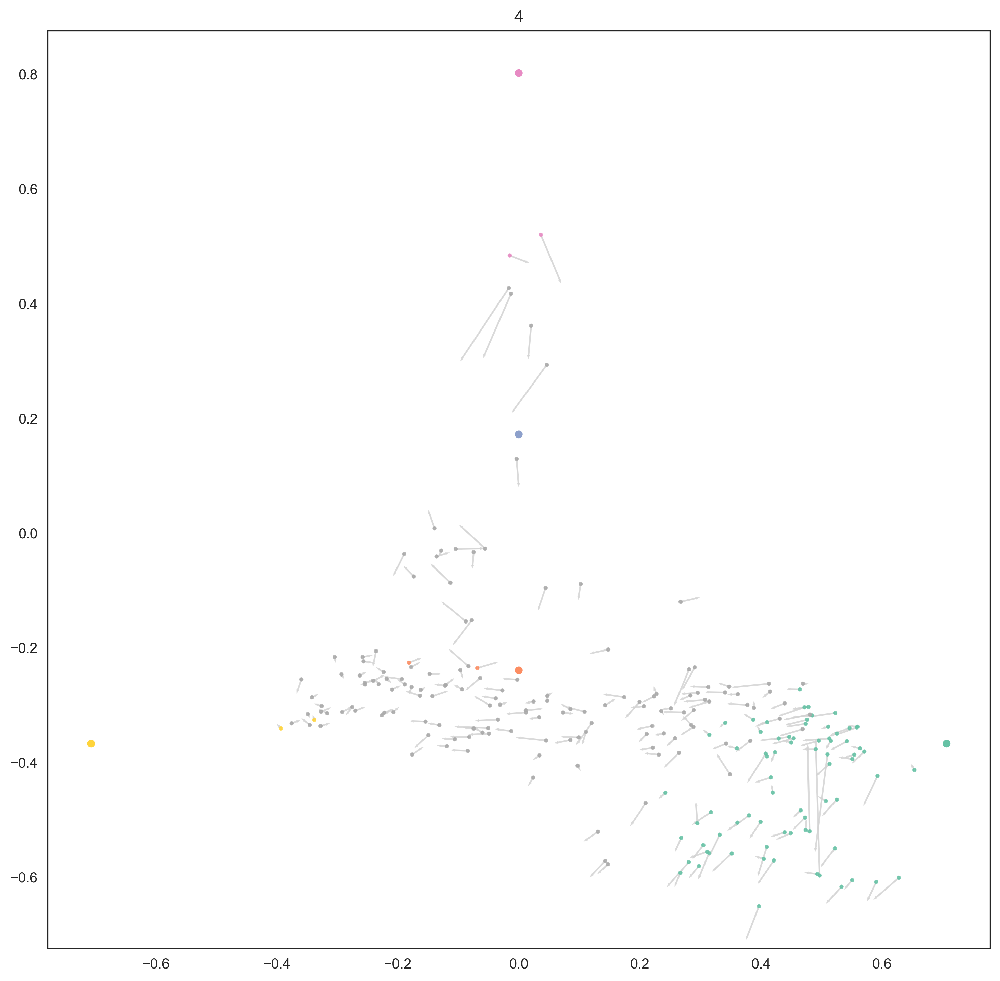

5
Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-A_Score'], dtype='object')


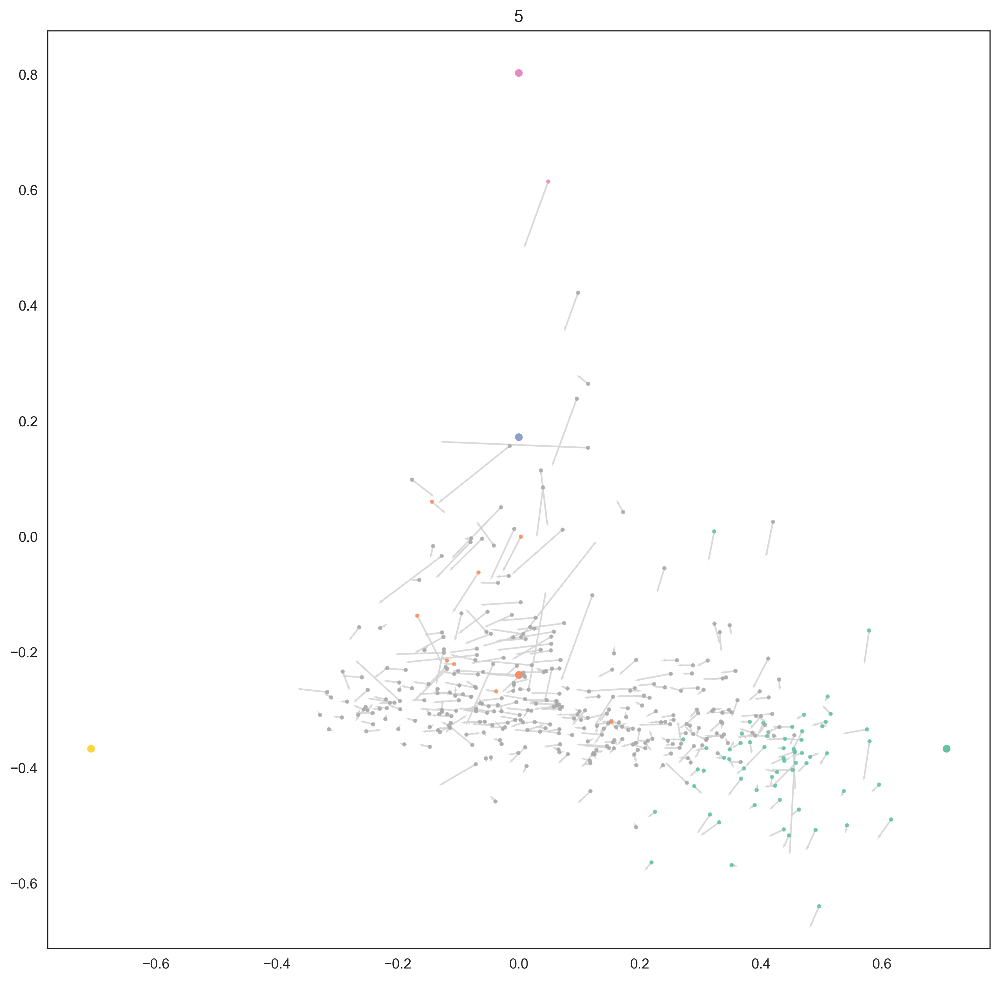

In [30]:
import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'white'}
mb.pl.archetype_diagrams(adata_small, sig_matrix, color_dict=color_dict, groupby='timepoint',color= 'Phenotype',
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',
                        multiplier=1, figsize=(12,12), score_name = '_Score', alpha = .8, s = 4, sizes = 20, arrows = True)



In [37]:
from sklearn.manifold import LocallyLinearEmbedding
def _archetype_diagram_no_arrows(_adata, score_name, color, figsize, order, multiplier,fname,
                                 sizes = None, alpha = .3, s = 30, color_dict = None, norm = 'scale'):
    # X = subtype scores for each subtype (pd dataframe)
    n_samples = len(_adata.obs_names)

    n_types = len(sig_matrix.columns)
    subtypes = sig_matrix.columns
    X = _adata.obs[[f"{x}{score_name}" for x in subtypes]]
    top = X.sum().sort_values(ascending=False)[:3]  # return a list of n largest element
    print(top.index)

    # normalize X to sum to 1 (makes sure that the data fits within the archetype diagram with I matrix = vertices
    X_norm = pd.DataFrame(columns=X.columns)
    if norm == 'scale':
        for i, r in X.iterrows():
            if r.sum() == 0:
                X_norm = X_norm.append(r)
            else:
                X_norm = X_norm.append(r / r.sum())
    elif norm == 'max':
        max = X.max().max()
        X_norm = X / max
    elif norm == 'None':
        X_norm = X

    X = X_norm.fillna(0)
    if type(order) != type(None):
        X = X[[f"{x}{score_name}" for x in order]]
        subtypes = order
    else:
        order = subtypes

    ident = np.identity(n_types)
    for i, x in enumerate(subtypes):
        X = X.append(pd.DataFrame(np.array(ident[i]), index=X.columns, columns=[x]).T)

    embedding = LocallyLinearEmbedding(n_components=2, n_neighbors=4, method='modified', eigen_solver='dense')
    X_transformed = embedding.fit_transform(X[-n_types:])
    X_transformed = X_transformed.T

    X_df_data = embedding.transform(X[:-n_types])
    X_df_data = X_df_data.T

    fig = plt.figure(figsize=figsize)

    ax = fig.add_subplot()
    colors = _adata.obs[color].values
#     if type(colors[0]) == str:
    c = [color_dict[i] for i in colors]
#     else:
#         c = colors
    plt.scatter(X_df_data[0], X_df_data[1], c=c, zorder=1, alpha=alpha, s=s)
    if type(sizes) == int:
        plt.scatter(X_transformed[0, -n_types:], X_transformed[1, -n_types:], c='black',
                    zorder=2, s=sizes)
    else:
        sizes = [Counter(colors)[i] * multiplier / n_samples for i in order]
        print(sizes)
        plt.scatter(X_transformed[0, -n_types:], X_transformed[1, -n_types:], c='black',
                zorder=2, s=sizes)
    plt.axis('tight')
    plt.savefig(f'./figures/{fname}.pdf')
    plt.show()
    plt.close()
    fig = plt.figure(figsize=figsize)

    ax = fig.add_subplot()
    colors = _adata.obs[color].values
    if type(colors[0]) == str:
        c = [color_dict[i] for i in colors]
    else:
        c = colors
    sns.kdeplot(X_df_data[0], X_df_data[1], cmap="Reds", shade=True, bw=.15)
    if type(sizes) == int:
        plt.scatter(X_transformed[0, -n_types:], X_transformed[1, -n_types:], c='black',
                    zorder=2, s=sizes)
    else:
        sizes = [Counter(colors)[i] * multiplier / n_samples for i in order]
        print(sizes)
        plt.scatter(X_transformed[0, -n_types:], X_transformed[1, -n_types:], c='black',
                    zorder=2, s=sizes)
    plt.axis('tight')
    plt.show()
    plt.close()


Index(['SCLC-A2_Score', 'SCLC-N_Score', 'SCLC-P_Score'], dtype='object')


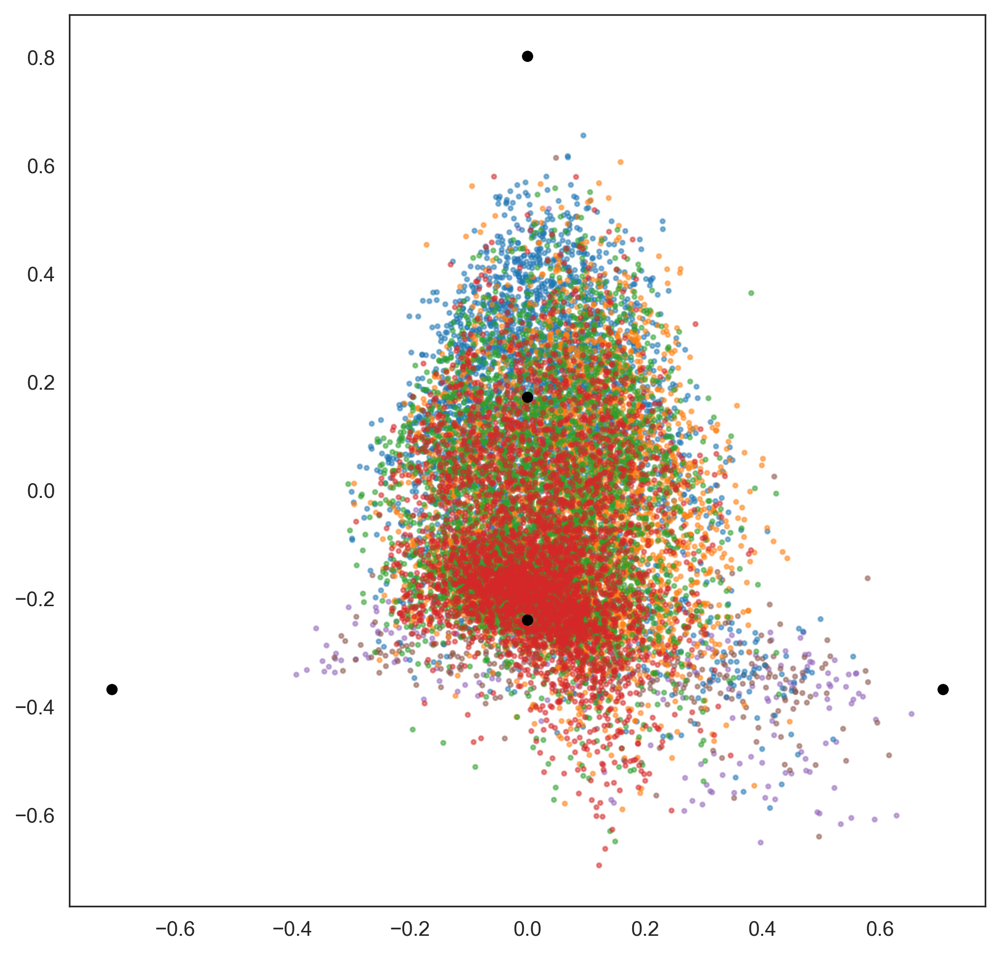

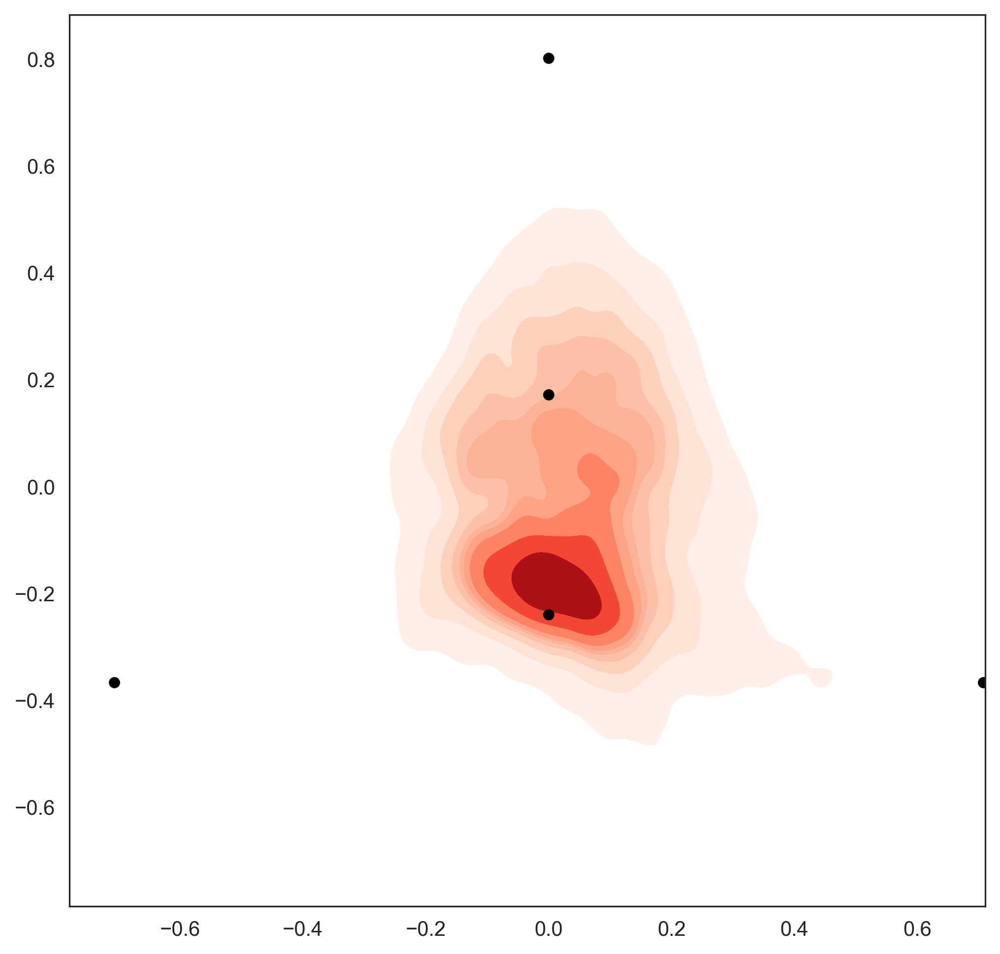

In [50]:
adata_small.obs['timepoint'] = adata_small.obs['timepoint'].astype('category')
color_dict = {}
for i,c in enumerate(sorted(list(set(adata_small.obs['timepoint'])))):
#     if i == 7:     color_dict[c] = sns.color_palette('tab10')[9] #skip grey
#     else:
    color_dict[c] = sns.color_palette('tab10',8)[i]
cmap = 'jet'
_archetype_diagram_no_arrows(adata_small, color_dict=color_dict,color='timepoint',fname = 'rpm_archetype_space',
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',
                        multiplier=1, figsize=(8,8), score_name = '_Score', alpha = .5, s = 4, sizes = 20)


In [13]:
adata.write_h5ad('../int/tko/adata06.h5ad')


## Network inference: Imputation of time points

In [57]:
mb.pp.magic_recipe(adata, [i.capitalize() for i in tfs], 'Phenotype_filtered', fname='rpm')


Calculating MAGIC...
  Running MAGIC on 15257 cells and 21163 genes.
  Calculating graph and diffusion operator...
    Calculating PCA...
    Calculated PCA in 10.95 seconds.
    Calculating KNN search...
    Calculated KNN search in 33.19 seconds.
    Calculating affinities...
    Calculated affinities in 31.84 seconds.
  Calculated graph and diffusion operator in 76.00 seconds.
  Calculating imputation...
  Calculated imputation in 0.08 seconds.
Calculated MAGIC in 83.04 seconds.
Calculating PCA...
Calculated PCA in 9.02 seconds.
Calculating imputation...
Calculated imputation in 0.08 seconds.


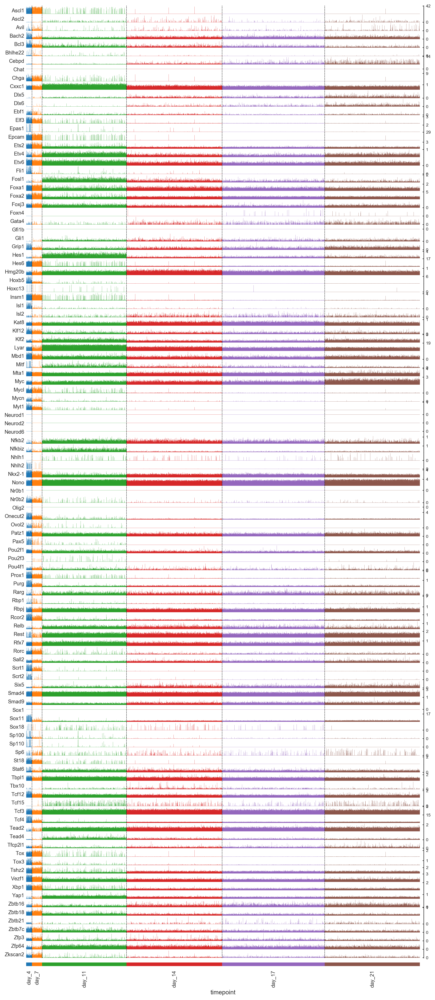

In [17]:
sc.pl.tracksplot(adata, var_names=sorted(list(set([i.capitalize() for i in tfs]).intersection(set(adata.var_names)))),
                 groupby='timepoint', layer = 'Ms')

In [8]:
mb.network.moments_recipe(adata, fname='rpm_nomagic', genes = [i.capitalize() for i in tfs], clusters='Phenotype_filtered')

Let's save the data at this point.

In [15]:
mb.pp.doublet_detections(adata,layer='matrix')
adata_small.obs['doublet_scores'] = adata.obs['doublet_scores']
adata_small.obs['predicted_doublets'] = adata.obs['predicted_doublets']

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.46
Detected doublet rate = 1.4%
Estimated detectable doublet fraction = 31.2%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 4.4%
Elapsed time: 11.7 seconds


Index(['SCLC-A_Score', 'SCLC-Y_Score', 'SCLC-A2_Score'], dtype='object')


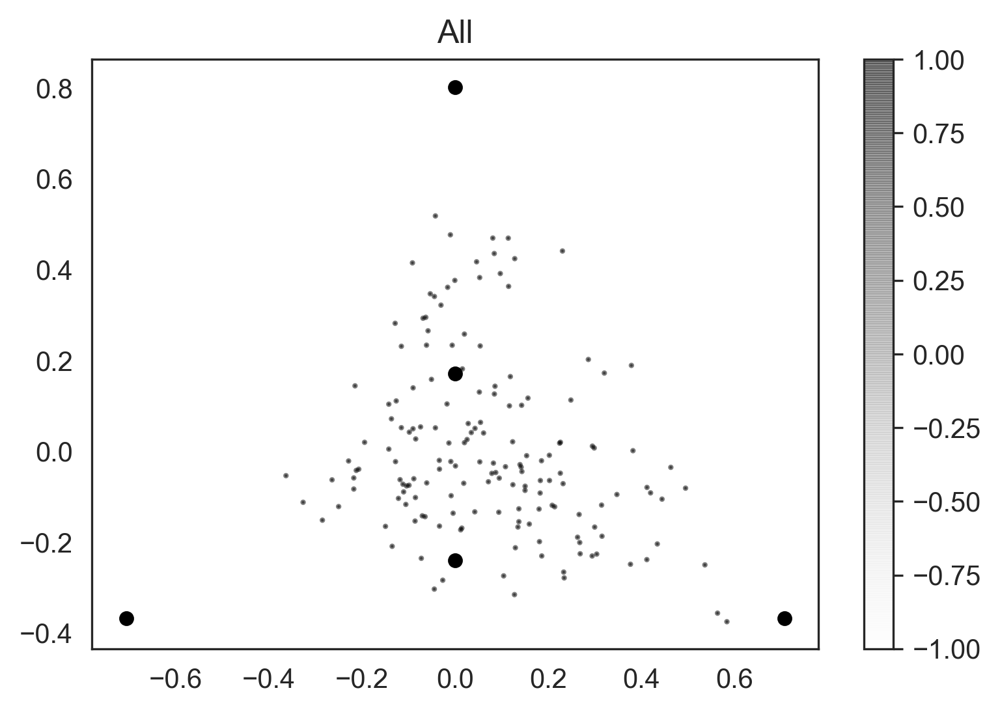

In [16]:

import matplotlib as mpl
mpl.rcParams['figure.dpi']= 300
cp = ['#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']
color_dict = {'SCLC-Y': cp[4], 'SCLC-A': cp[0], 'SCLC-A2': cp[1], 'SCLC-N': cp[2], 'SCLC-P': cp[3],
              'Generalist': 'darkgray', 'None': 'lightgrey'}
mb.pl.archetype_diagrams(adata_small[adata_small.obs['predicted_doublets'] == True], sig_matrix, color_dict=color_dict, groupby='None',color='predicted_doublets',grid = False,
                        order = ['SCLC-Y','SCLC-A','SCLC-P','SCLC-N','SCLC-A2'], norm = 'None',num_steps = 40,cmap = 'Greys',
                        multiplier=1, figsize=(6,4), score_name = '_Score', alpha = .5, s = 1, sizes = 20)



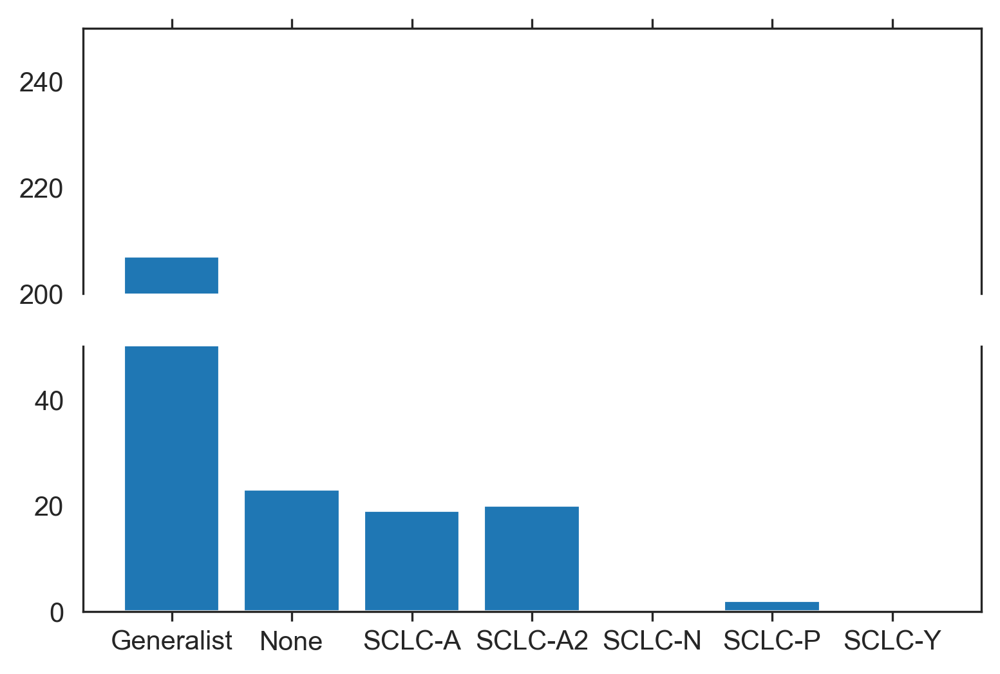

In [51]:
f, (ax, ax2) = plt.subplots(2, 1, sharex=True, figsize = (6,4))

# plot the same data on both axes
ax.bar(pd.crosstab(adata_small.obs['Phenotype'], adata_small.obs['absorbing']).index, 
       pd.crosstab(adata_small.obs['Phenotype'], adata_small.obs['absorbing'])['True'])
ax2.bar(pd.crosstab(adata_small.obs['Phenotype'], adata_small.obs['absorbing']).index, 
       pd.crosstab(adata_small.obs['Phenotype'], adata_small.obs['absorbing'])['True'])
# zoom-in / limit the view to different portions of the data
ax.set_ylim(200, 250)  # outliers only
ax2.set_ylim(0, 50)  # most of the data

# hide the spines between ax and ax2
ax.spines['bottom'].set_visible(False)
ax2.spines['top'].set_visible(False)
ax.xaxis.tick_top()
ax.tick_params(labeltop=False)  # don't put tick labels at the top
ax2.xaxis.tick_bottom()
plt.savefig('./figures/absorbing_tkos.pdf')

In [52]:
cp_all = ['#a9a9a9','#d3d3d3','#fc8d62', '#66c2a5', '#FFD43B', '#8da0cb', '#e78ac3']


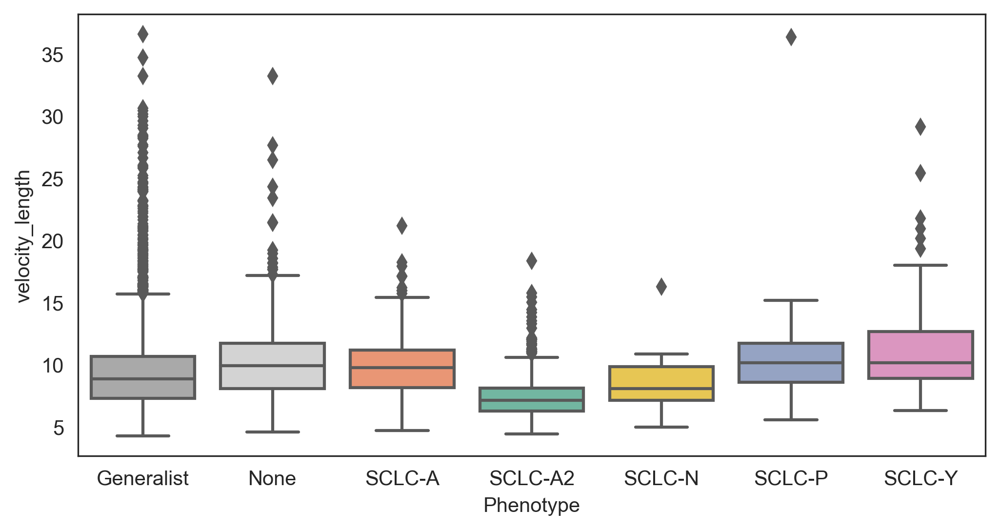

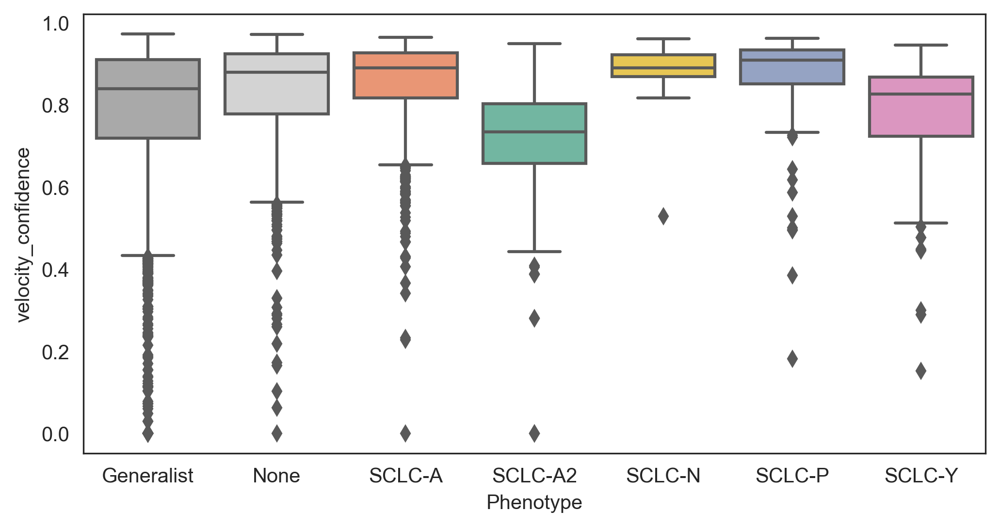

In [54]:
sns.boxplot(adata_small.obs['Phenotype'], adata_small.obs['velocity_length'], palette = cp_all,
                      order = sorted(set(adata_small.obs['Phenotype'])))
plt.figure()
sns.boxplot(adata_small.obs['Phenotype'], adata_small.obs['velocity_confidence'], palette = cp_all,
                       order = sorted(set(adata_small.obs['Phenotype'])))


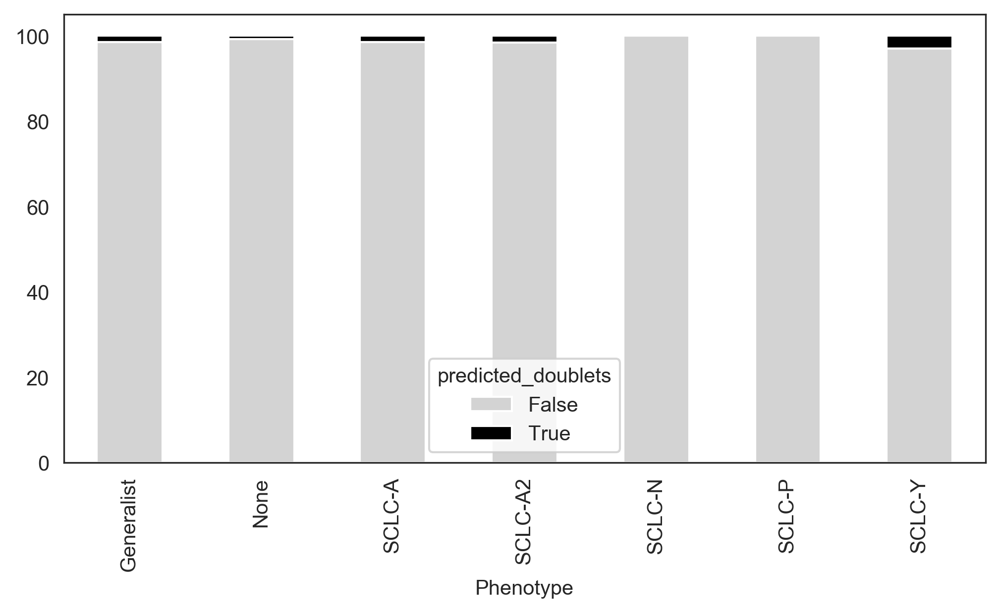

In [49]:

plt.rcParams["figure.figsize"] = [8, 4]
((pd.crosstab(adata_small.obs['predicted_doublets'], adata_small.obs['Phenotype'])/
  pd.crosstab(adata_small.obs['predicted_doublets'], adata_small.obs['Phenotype']).sum(axis = 0))*100).T.plot.bar(stacked = True,color = ['#d3d3d3','black'])
plt.savefig('./figures/tko_doublets.pdf')